In [2]:
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
import os
import matplotlib.dates as mdates
import cmocean as cm
import waypoint_distance as wd
import pandas as pd

def clean_mission(file_pathway):
    """
    Clean and interpolate a glider mission by splitting into outbound and return legs
    using the peak of the along-transect distance.

    Returns:
        ds_out: outbound transect
        ds_return: return transect (or None if missing)
    """
    ds = xr.open_dataset(file_pathway)

    # Project onto along/across coordinate system
    waypoint_lon = np.array([-127.950, -128.115, -128.243, -128.514, -128.646, -128.798])
    waypoint_lat = np.array([51.757, 51.705, 51.715, 51.450, 51.4165, 51.408])
    central_lat = 51.715

    alongx, acrossx, _ = wd.get_simple_distance(
        shiplon=ds['longitude'].values,
        shiplat=ds['latitude'].values,
        wplon=waypoint_lon,
        wplat=waypoint_lat,
        central_lat=central_lat)

    ds = ds.assign(along=('time', alongx), across=('time', acrossx))

    # Split at maximum along distance (turnaround point)
    peak_idx = int(np.argmax(ds['along'].values))

    ds_out = ds.isel(time=slice(0, peak_idx + 1))
    ds_return = ds.isel(time=slice(peak_idx + 1, None))

    # Clean loops separately in each leg
    for leg, name in [(ds_out, "out"), (ds_return, "return")]:
        if leg['time'].size < 2 or np.count_nonzero(~np.isnan(leg['along'])) < 10:
            print(f"Skipping {name} leg: not enough points to clean.")
            if name == "out":
                ds_out = None
            else:
                ds_return = None
            continue

        prev_len = -1
        while prev_len != len(leg['time']):
            prev_len = len(leg['time'])
            if len(leg['along']) < 2:
                print(f"Stopping cleaning for {name} leg: insufficient points for gradient.")
                break
            grad = np.gradient(leg['along'])
            keep_mask = grad > 0 if name == "out" else grad < 0
            leg = leg.sel(time=keep_mask)

        # Final filtering: must have enough non-NaN `along` values
        if np.count_nonzero(~np.isnan(leg['along'])) < 100:
            print(f"Dropping {name} leg after cleaning: too few valid points.")
            if name == "out":
                ds_out = None
            else:
                ds_return = None
            continue

        if name == "out":
            ds_out = interpolate(leg.set_coords('along'))
        else:
            ds_return = interpolate(leg.set_coords('along'))

    # Assign mission type
    if ds_out is not None:
        ds_out = ds_out.assign_coords(mission_type='Outbound')
    if ds_return is not None:
        ds_return = ds_return.assign_coords(mission_type='Return')
    
    # # Remove low-data transects
    # min_valid_cols = 150  # You can adjust this
    # if ds_out is not None:
    #     valid_out = np.sum(~np.isnan(ds_out['temperature'].isel(depth=0)))
    #     if valid_out < min_valid_cols:
    #         print(f"Skipping outbound: only {valid_out} valid columns")
    #         ds_out = None

    # if ds_return is not None:
    #     valid_return = np.sum(~np.isnan(ds_return['temperature'].isel(depth=0)))
    #     if valid_return < min_valid_cols:
    #         print(f"Skipping return: only {valid_return} valid columns")
    #         ds_return = None

    return ds_out, ds_return

def interpolate(ds):
    """
    Interpolate the dataset to a regular grid along the 'along' dimension.
    """
    # Drop duplicate 'along' values
    _, index_unique = np.unique(ds['along'], return_index=True)
    ds = ds.isel(time=index_unique)

    # Create mission-specific along grid
    min_along = np.floor(ds['along'].min().item() / 200) * 200
    max_along = np.ceil(ds['along'].max().item() / 200) * 200
    along_grid = np.arange(min_along, max_along + 1, 200)

    # Swap and interpolate
    ds = ds.swap_dims({'time': 'along'})
    ds_interp = ds.interp(along=along_grid)

    # Interpolate time (linearly)
    interp_time = np.interp(
        along_grid,
        ds['along'].values,
        ds['time'].values.astype('datetime64[ns]').astype('float64'),
        left=np.nan,
        right=np.nan
    )
    ds_interp['time'] = ('along', interp_time.astype('datetime64[ns]'))

    return ds_interp

def append_to_calvert_cube(ds_transect, cube_path='~/Desktop/calvert_cube.nc', source_file=None):
    cube_path = os.path.expanduser(cube_path)

    # Ensure transect dim exists
    if 'transect' not in ds_transect.dims:
        ds_transect = ds_transect.expand_dims(transect=[0])

    # Add transect_time using first valid timestamp
    if 'transect_time' not in ds_transect.coords:
        valid_times = pd.to_datetime(ds_transect['time'].values, errors='coerce').dropna()
        transect_time = np.datetime64(valid_times[0]) if len(valid_times) > 0 else np.datetime64('NaT')
        ds_transect = ds_transect.assign_coords(transect_time=('transect', [transect_time]))

    # Add source file tag
    if source_file:
        ds_transect.attrs['source_file'] = os.path.basename(source_file)

    # If cube doesn't exist, write the first transect
    if not os.path.exists(cube_path):
        ds_transect.to_netcdf(cube_path)
        print(f"Created new cube: {cube_path}")
        return

    # Load existing cube
    cube = xr.open_dataset(cube_path)
    cube.load(); cube.close()

    # Check if file is already in the cube
    processed_files = cube.attrs.get('source_file', [])
    if isinstance(processed_files, str):
        processed_files = [processed_files]
    if os.path.basename(source_file) in processed_files:
        print(f"Skipping {source_file}: already in cube.")
        return

    # Assign new transect index
    new_index = cube.sizes['transect']
    ds_transect = ds_transect.assign_coords(transect=[new_index])
    ds_combined = xr.concat([cube, ds_transect], dim='transect')

    # Sort by transect_time
    ds_combined = ds_combined.sortby('transect_time')

    # Update cube-level metadata
    ds_combined.attrs['source_file'] = processed_files + [os.path.basename(source_file)]
    ds_combined.to_netcdf(cube_path, mode='w')
    print(f"Appended to cube: {source_file}")


def add_file_to_cube(filepath):
    ds_out, ds_return = clean_mission(filepath)
    if ds_out is not None:
        append_to_calvert_cube(ds_out, source_file=filepath + "_out")
    else:
        print(f"Skipped outbound transect for {filepath}")
    if ds_return is not None:
        append_to_calvert_cube(ds_return, source_file=filepath + "_return")
    else:
        print(f"Skipped return transect for {filepath}")

In [2]:
# 'Users/martinwilliamson/CalvertLine_reprocessed/dfo-bb046-20200717_grid_delayed.nc'
# '/Users/martinwilliamson/CalvertLine_reprocessed/dfo-bb046-20200810_grid_delayed.nc'
# '/Users/martinwilliamson/CalvertLine_reprocessed/dfo-bb046-20200908_grid_delayed.nc'
# '/Users/martinwilliamson/CalvertLine_reprocessed/dfo-bb046-20210324_grid_delayed.nc'
# '/Users/martinwilliamson/CalvertLine_reprocessed/dfo-bb046-20210511_grid_delayed.nc',

In [21]:
# Print mission types for all transects
# Correct way to access it:
if 'mission_type' in cube.coords:
    print(cube.coords['mission_type'].values)

['Outbound' 'Return' 'Outbound' 'Outbound' 'Return' 'Outbound' 'Return'
 'Outbound' 'Return' 'Outbound' 'Return' 'Outbound' 'Return' 'Outbound'
 'Return' 'Outbound' 'Return' 'Outbound' 'Return' 'Outbound' 'Return'
 'Outbound' 'Return' 'Outbound' 'Return' 'Outbound' 'Return' 'Outbound'
 'Outbound' 'Return' 'Outbound' 'Return' 'Return' 'Outbound' 'Return'
 'Return' 'Outbound' 'Return' 'Return' 'Outbound' 'Return']


In [ ]:
def plot_section(ds, xlim = 77):
    """
    Plot temperature section for a given file

    Parameters:
    - ds: xarray.Dataset, a .nc file for each transect
    - temp_bounds: tuple, (min, max) temperature values for colormap.
    """

    plt.rcParams.update({
        'font.size': 12,
        'axes.titlesize': 20,
        'axes.labelsize': 20,
        'xtick.labelsize': 15,
        'ytick.labelsize': 15,
        'legend.fontsize': 20,
        'figure.titlesize': 20})
    
    topo_file = os.path.expanduser('~/Desktop/british_columbia_3_msl_2013.nc')
    topo = xr.open_dataset(topo_file)
    ds = ds
    temp_bounds = (5.3, 10)
    # Extract coordinates and data
    along = ds['along'].values
    depth = ds['depth'].values
    temperature = ds['temperature'].values
    pdens = ds['potential_density'].values - 1000  # Sigma-theta

    # Interpolate bathymetry over full along track
    full_lon = ds['longitude'].values
    full_lat = ds['latitude'].values

    interp_bathy = topo['Band1'].interp(
        lon=xr.DataArray(full_lon, dims='along'),
        lat=xr.DataArray(full_lat, dims='along'),
        method='nearest')
    bottom_depths = -interp_bathy.values  # 1D array for full along

    # Plot temperature section
    fig, ax = plt.subplots(figsize=( 1.5 * 1.5 * 6.4, 1.5 * 4.8))
    # Create meshgrid of depth and along
    depth_grid, along_grid = np.meshgrid(depth, along, indexing='ij')

    # Expand bottom_depths to match depth grid shape
    bathymetry_floor = np.tile(bottom_depths, (len(depth), 1))

    # Create mask where depth > bottom
    mask = depth_grid > bathymetry_floor

    # Plot grey background
    ax.contourf(along / 1000, depth, mask,
                levels=[0.5, 1.5], colors='grey', zorder=1)
    cf = ax.pcolormesh(along / 1000, depth, temperature, shading='auto',
                        cmap=cm.cm.thermal, vmin=temp_bounds[0], vmax=temp_bounds[1])

    # Bathymetry
    ax.plot(along / 1000, bottom_depths, color='black', linewidth=2)

    # Isopycnal contours
    for levels, color, lw in [
        (np.linspace(24, 27, 7), 'black', 0.5),
        ([26.6], 'white', 2),
        ([26.7], 'lime', 2),
        ([26.8], 'red', 2),
        ([26.9], 'blue', 2)]:
        cf_iso = ax.contour(along / 1000, depth, pdens, levels=levels,
                            colors=color, linewidths=lw, linestyles='-')
        if lw != 0.3:
            ax.clabel(cf_iso, fmt='%1.2f')

    time_top = ds['time'].values  # shape (along,)
    along_km = along / 1000

    # Number of ticks you want
    nticks = 8
    idx_ticks = np.linspace(0, len(along_km) - 1, nticks, dtype=int)

    tick_locs = along_km[idx_ticks]
    tick_times = time_top[idx_ticks]

    # Remove NaT values
    valid_mask = ~pd.isna(tick_times)
    tick_locs = tick_locs[valid_mask]
    tick_times = tick_times[valid_mask]

    # Format with hour and date
    tick_labels = [pd.to_datetime(t).strftime('%b %d %H:%M') for t in tick_times]

    # Add secondary x-axis with formatted time ticks
    ax_top = ax.secondary_xaxis('top')
    ax_top.set_xticks(tick_locs)
    ax_top.set_xticklabels(tick_labels, rotation=30, ha='center', fontsize=10)

    # Labels and formatting
    ax.set_xlabel('Along-Transect Distance (km)')
    ax.set_ylabel('Depth (m)')
    ax.invert_yaxis()
    ax.set_ylim(410, 0)
    ax.set_xlim(xlim,0)
    tstr = str(ds['transect_time'].values.astype('datetime64[D]'))
    ax.set_title(f'Temperature Section ({tstr})')
    plt.colorbar(cf, ax=ax, label='Temperature (°C)')
    plt.tight_layout()


📈 Plotting: transect from 2019-06-12


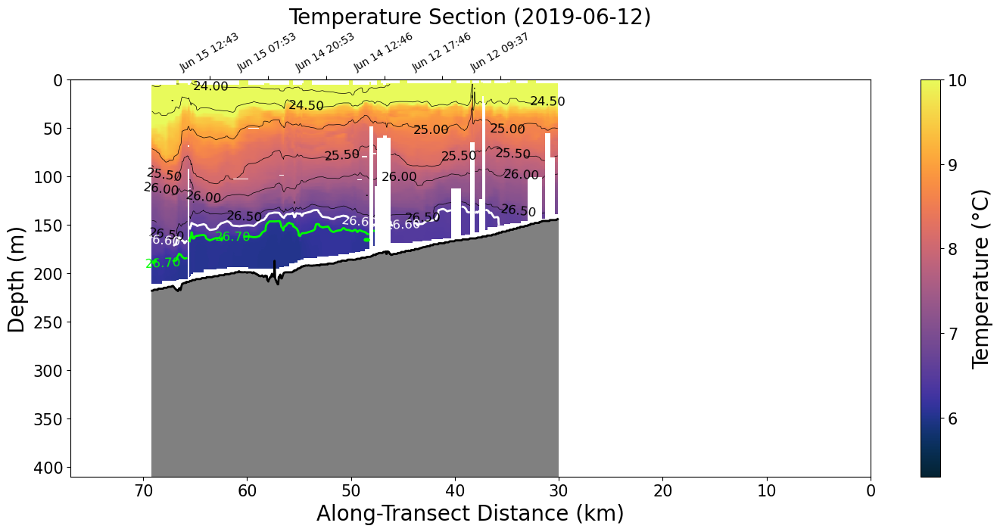

📈 Plotting: transect from 2019-06-13


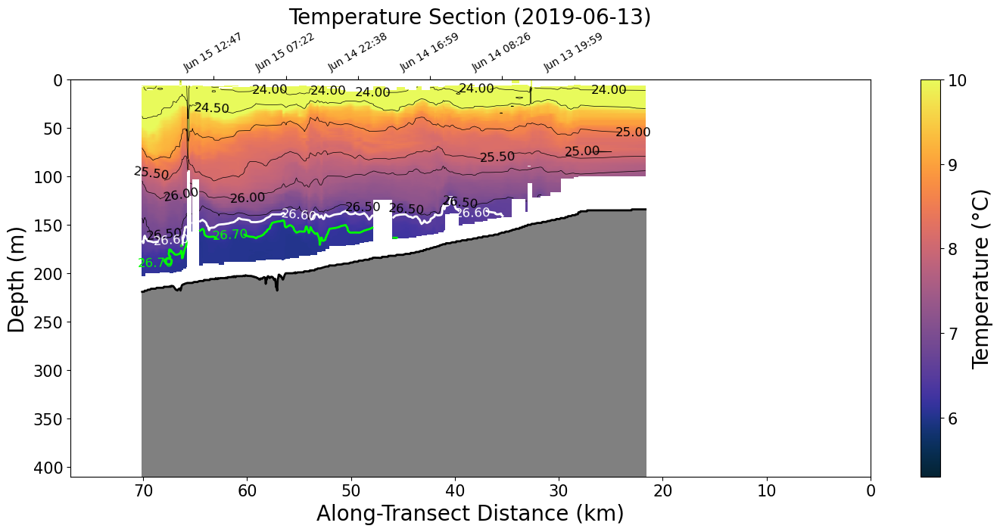

📈 Plotting: transect from 2019-06-15


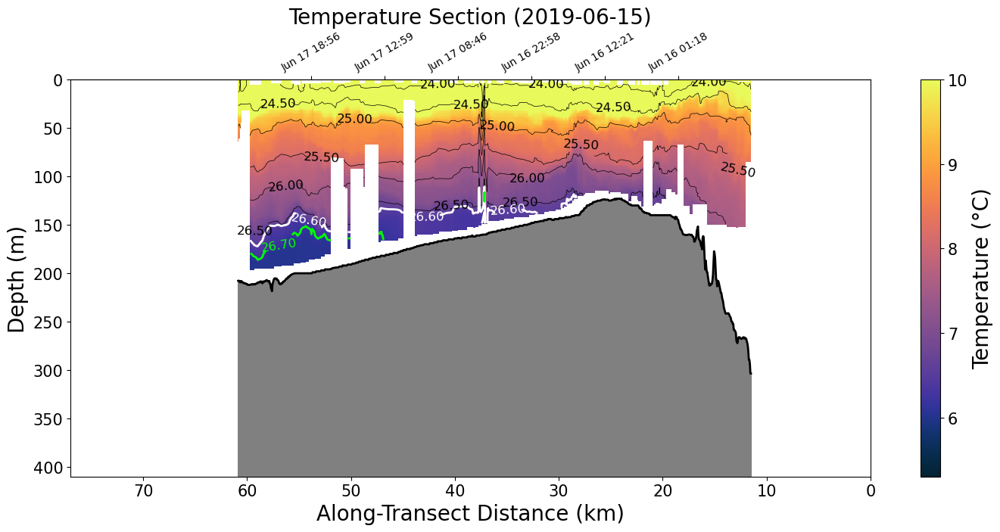

📈 Plotting: transect from 2019-06-21


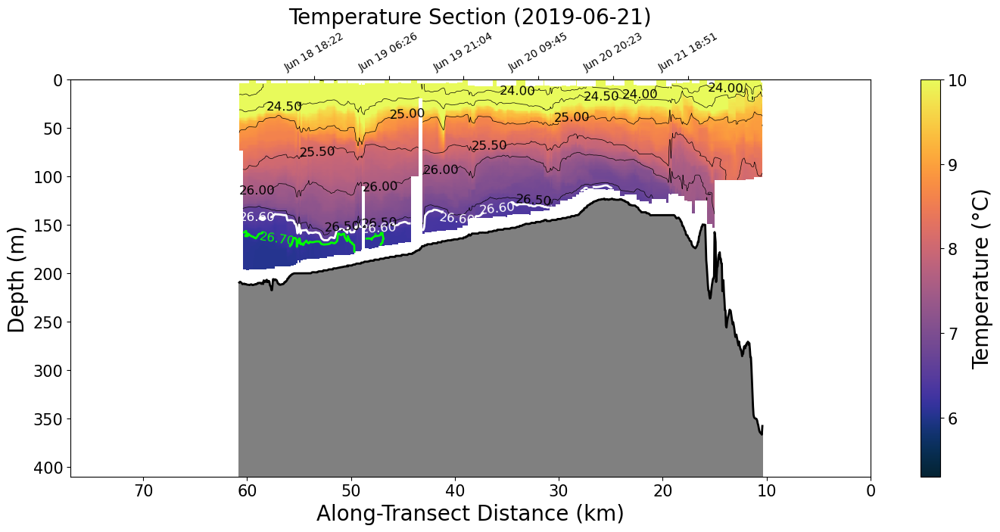

📈 Plotting: transect from 2019-06-23


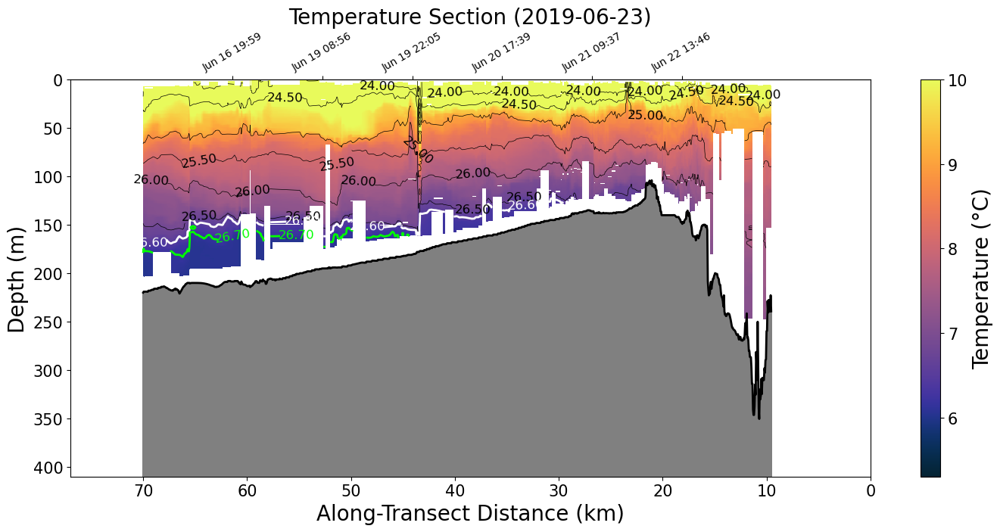

📈 Plotting: transect from 2020-07-17


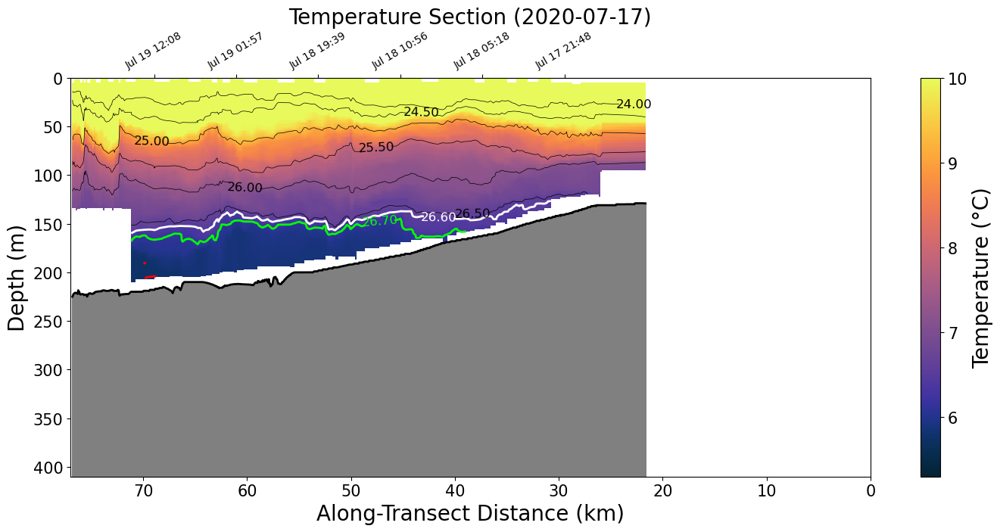

📈 Plotting: transect from 2020-08-10


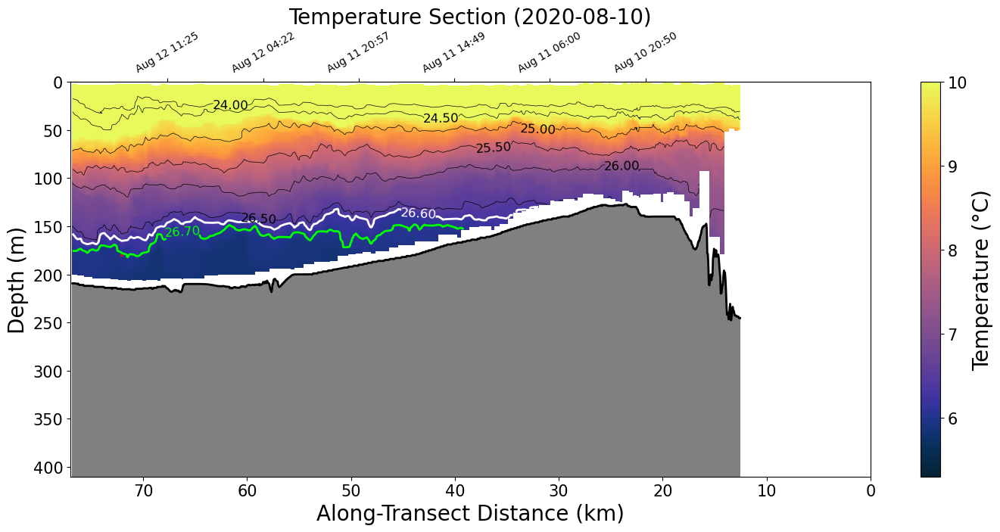

📈 Plotting: transect from 2020-09-02


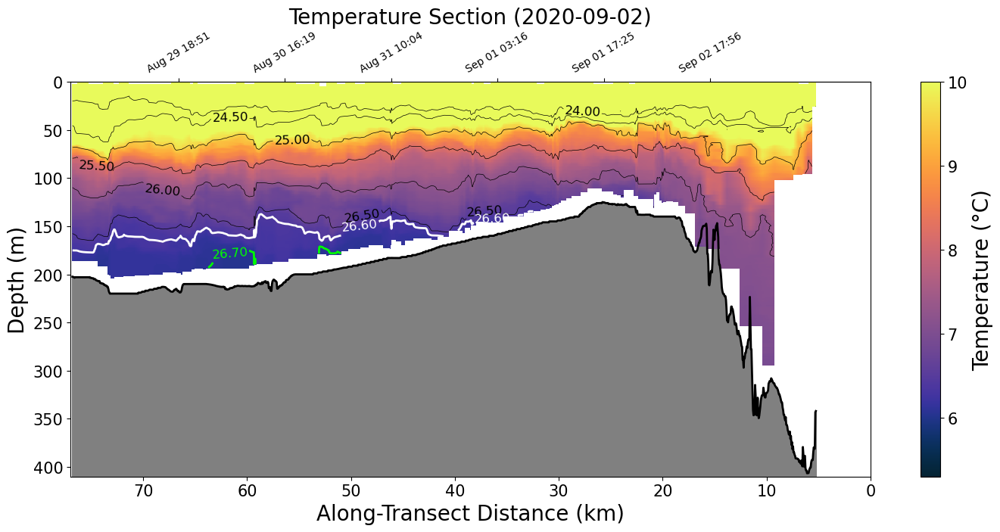

📈 Plotting: transect from 2020-09-08


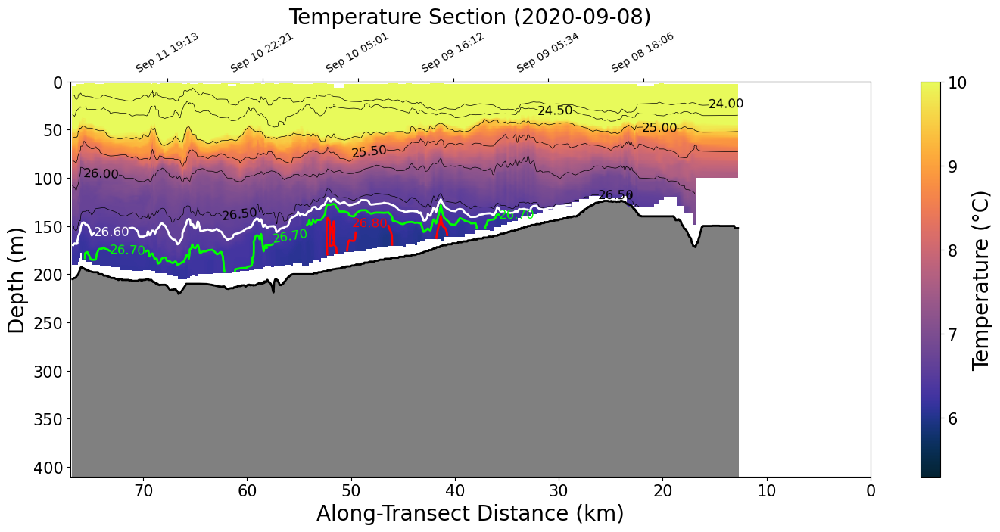

📈 Plotting: transect from 2020-09-30


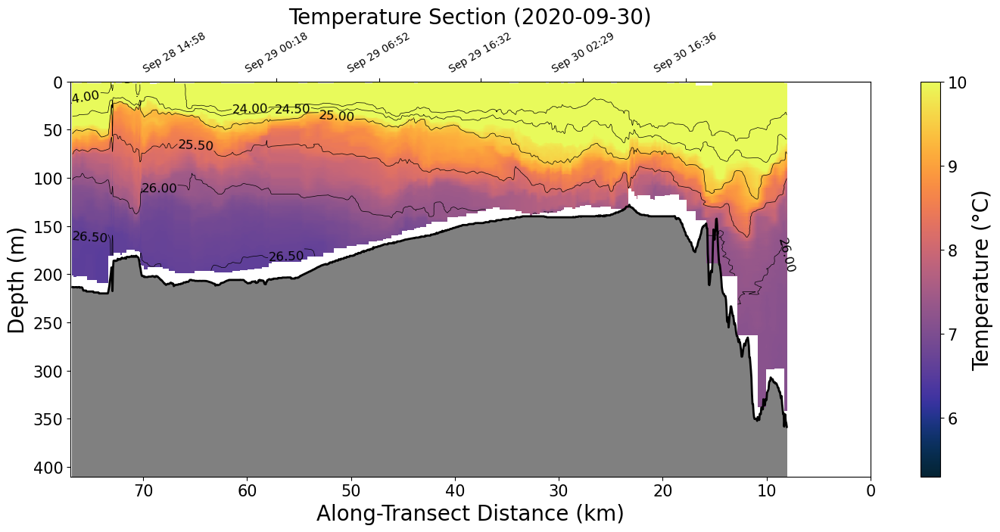

📈 Plotting: transect from 2020-10-06


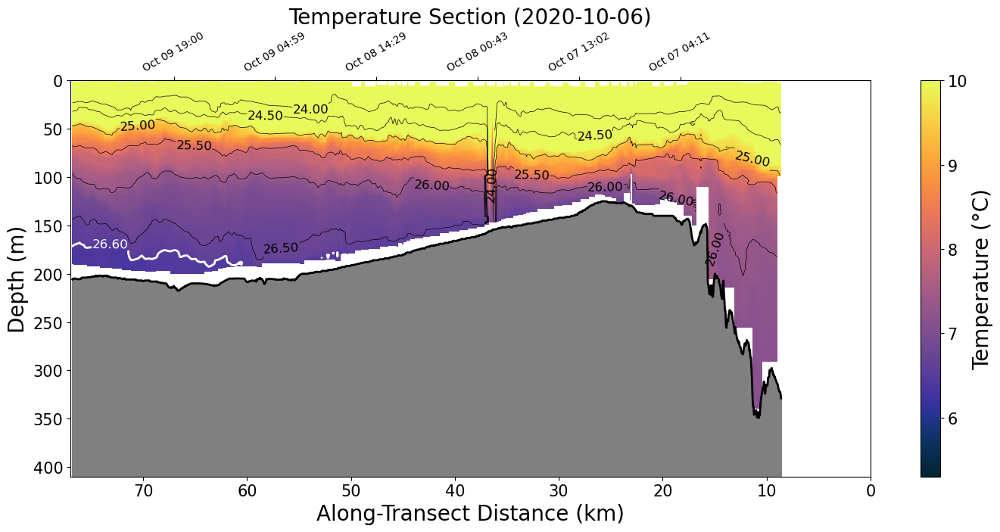

📈 Plotting: transect from 2020-10-28


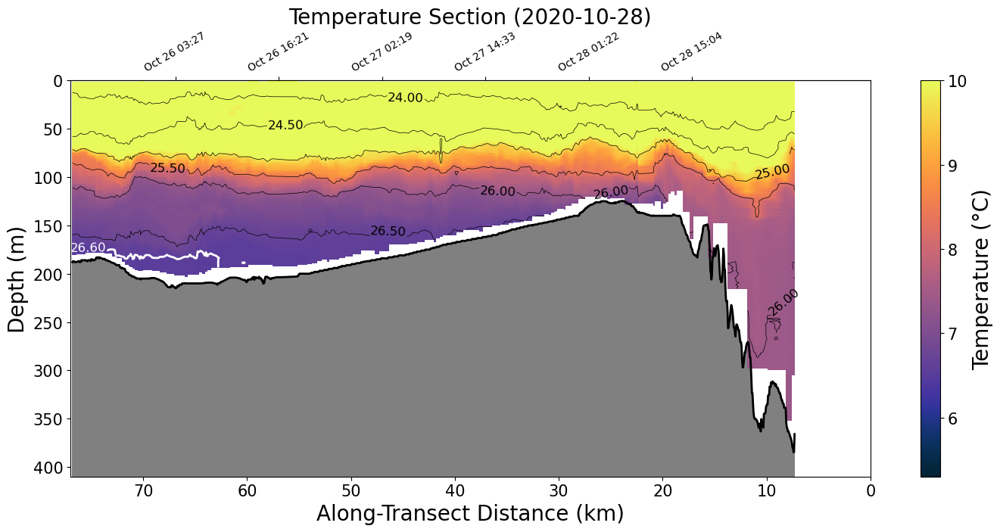

📈 Plotting: transect from 2020-11-03


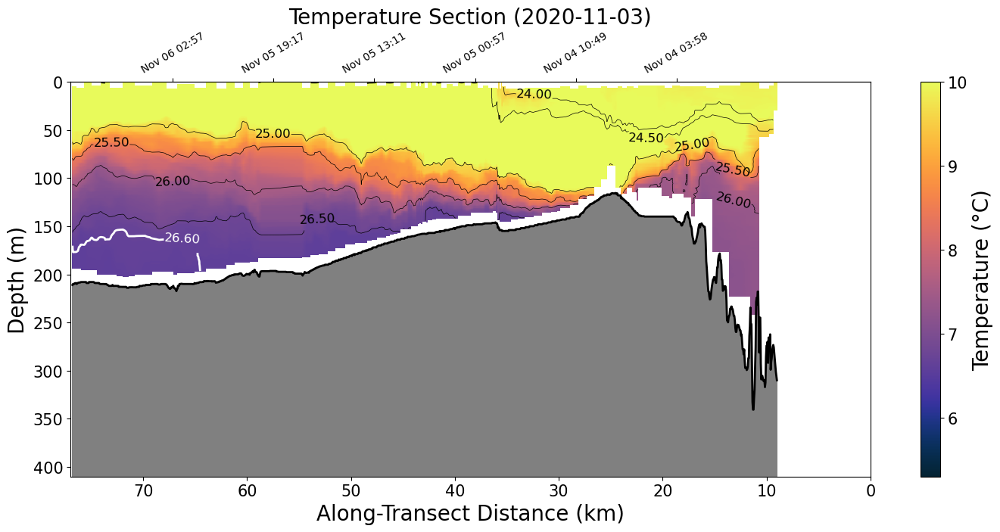

📈 Plotting: transect from 2020-11-26


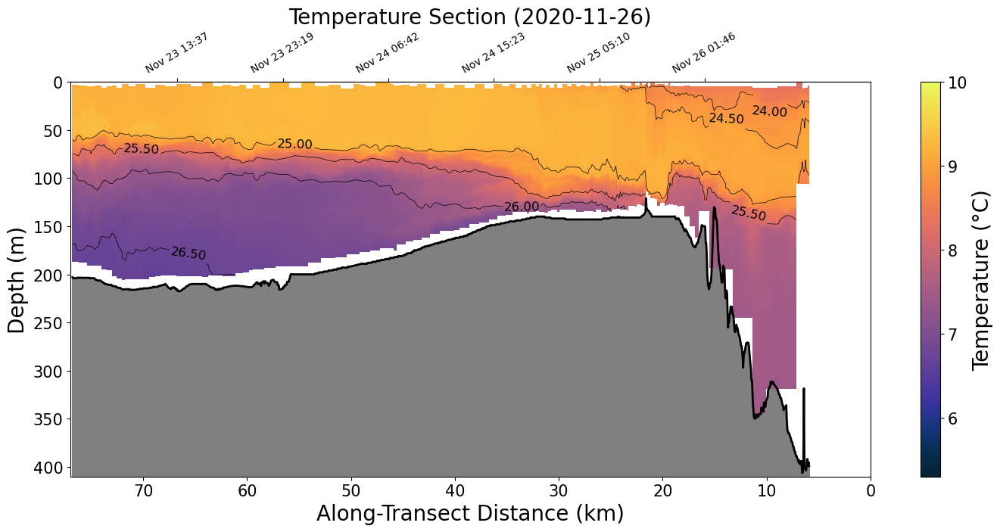

📈 Plotting: transect from 2021-02-12


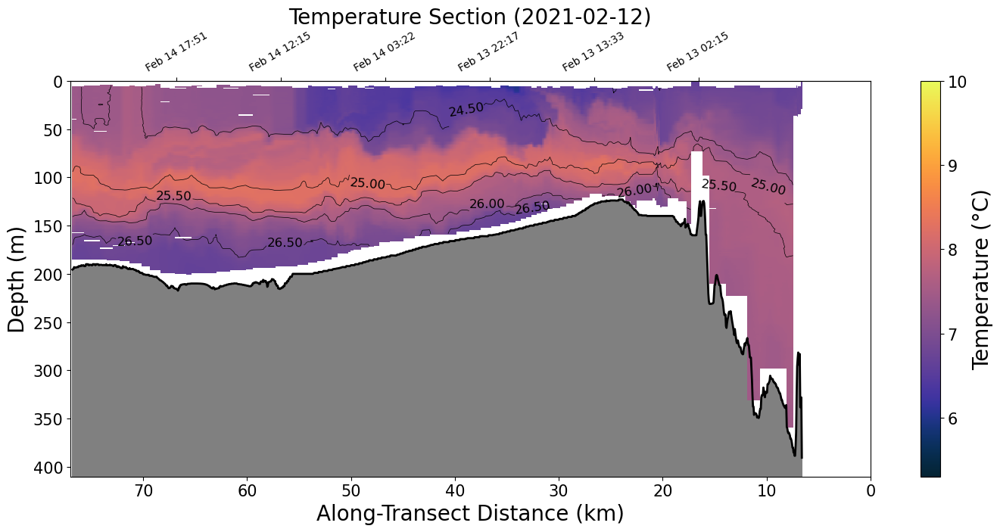

📈 Plotting: transect from 2021-03-10


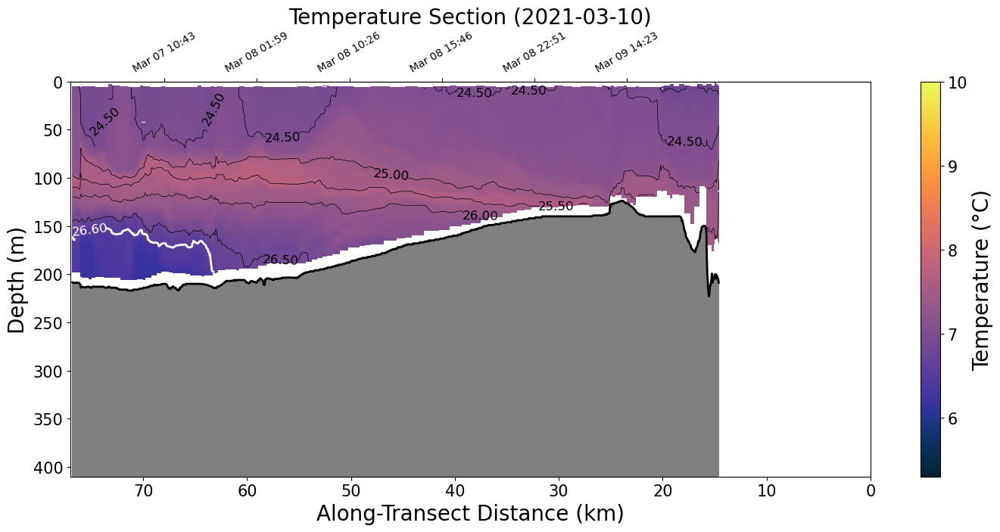

📈 Plotting: transect from 2021-03-25


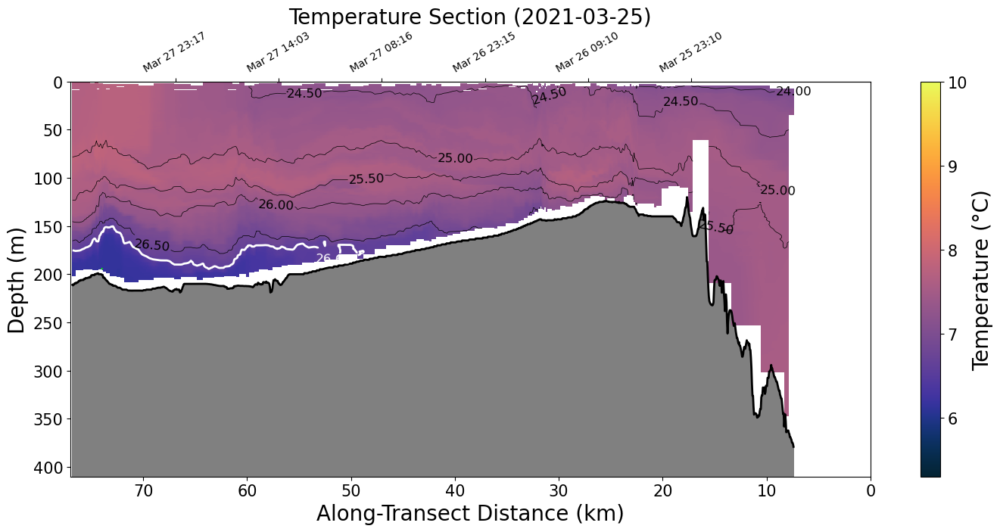

📈 Plotting: transect from 2021-04-08


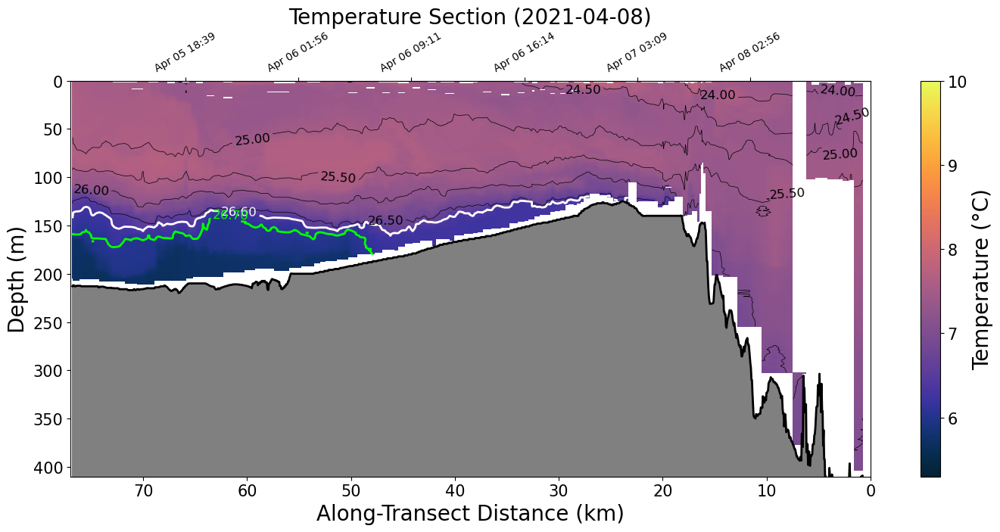

📈 Plotting: transect from 2021-04-13


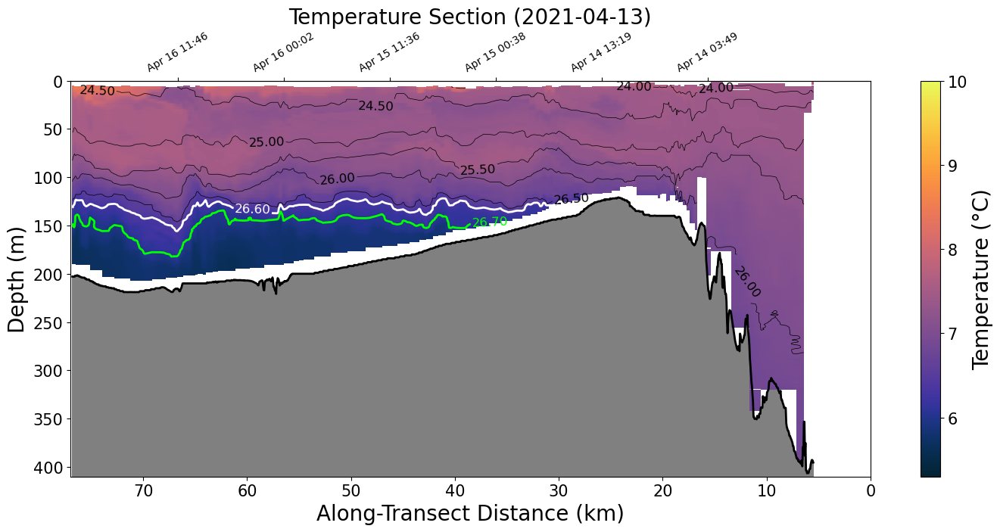

📈 Plotting: transect from 2021-05-05


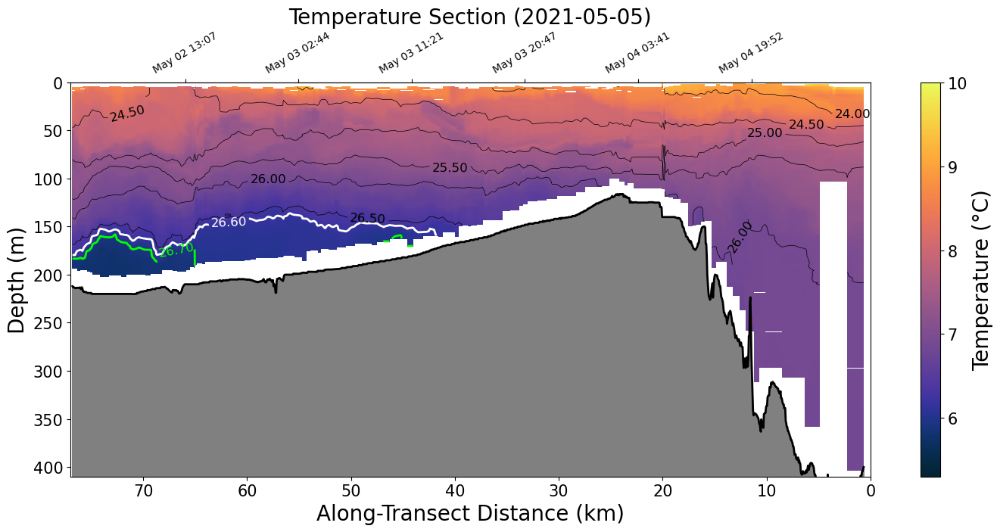

📈 Plotting: transect from 2021-05-11


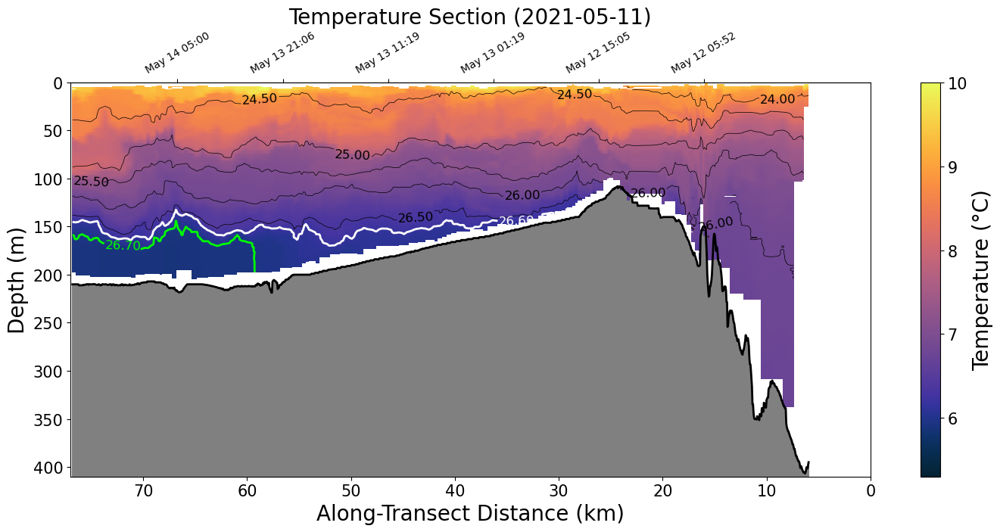

📈 Plotting: transect from 2021-06-03


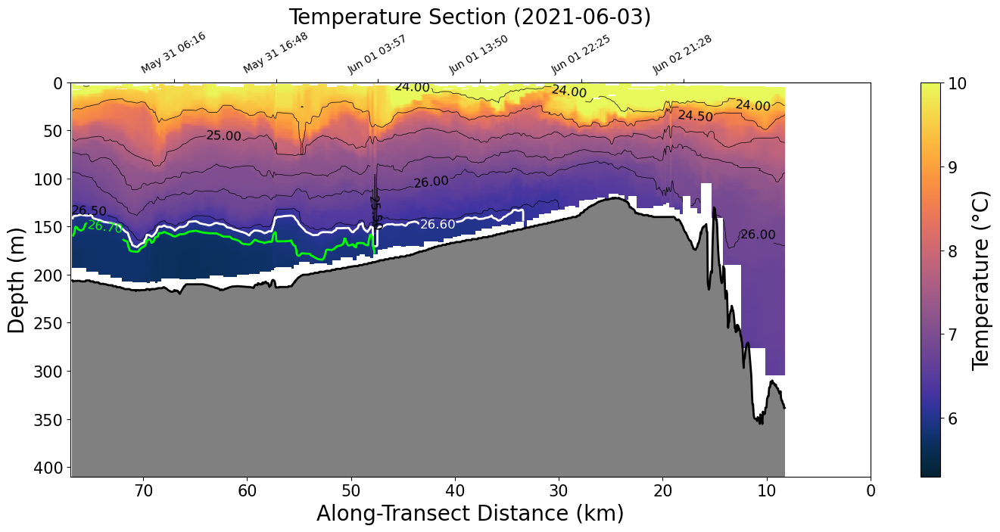

📈 Plotting: transect from 2021-07-04


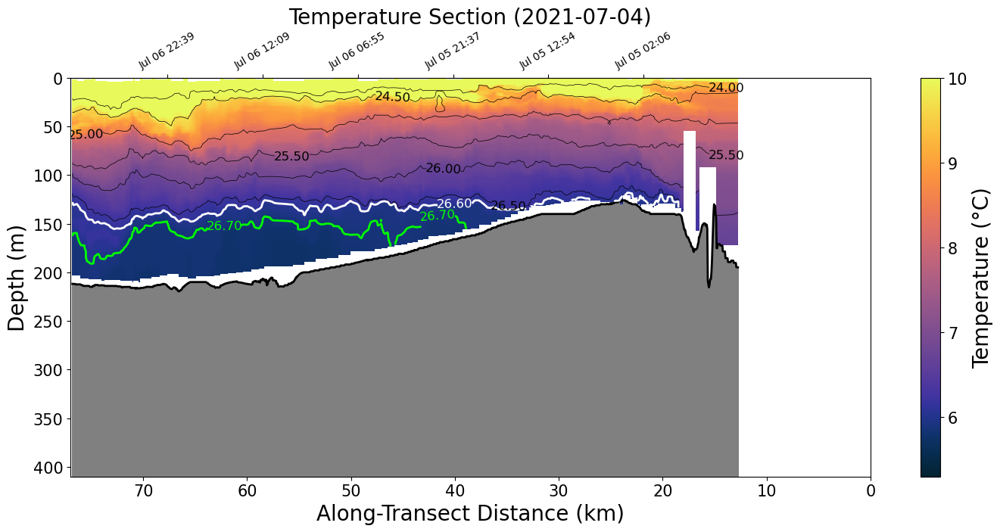

📈 Plotting: transect from 2022-06-08


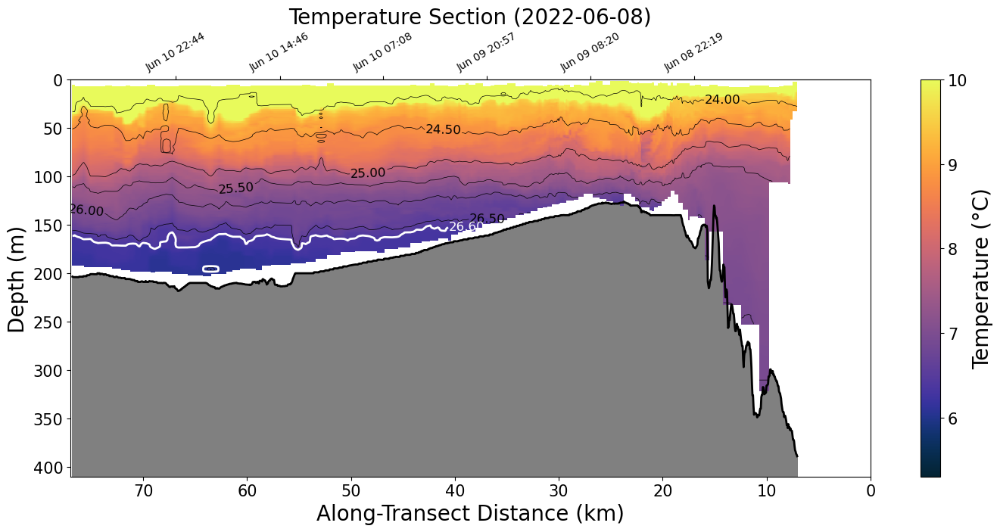

📈 Plotting: transect from 2022-07-01


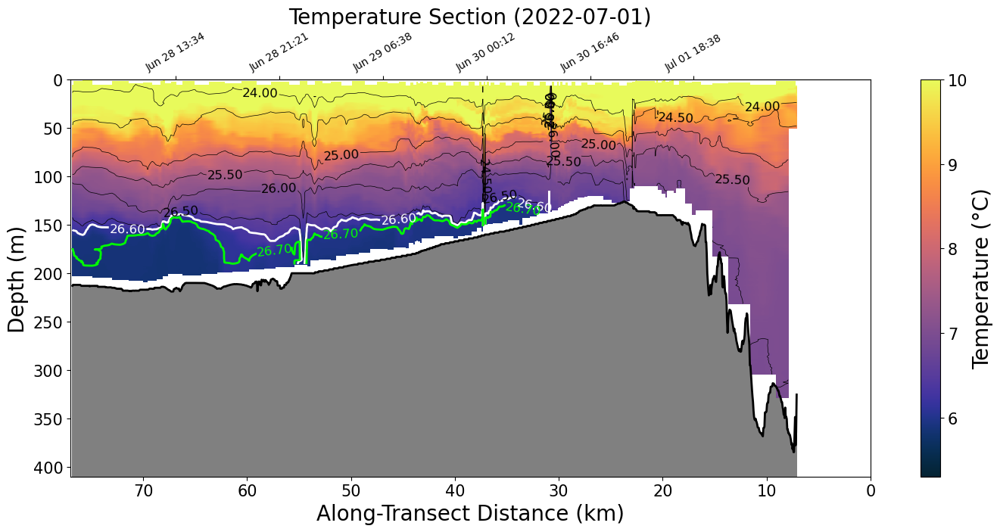

📈 Plotting: transect from 2022-07-07


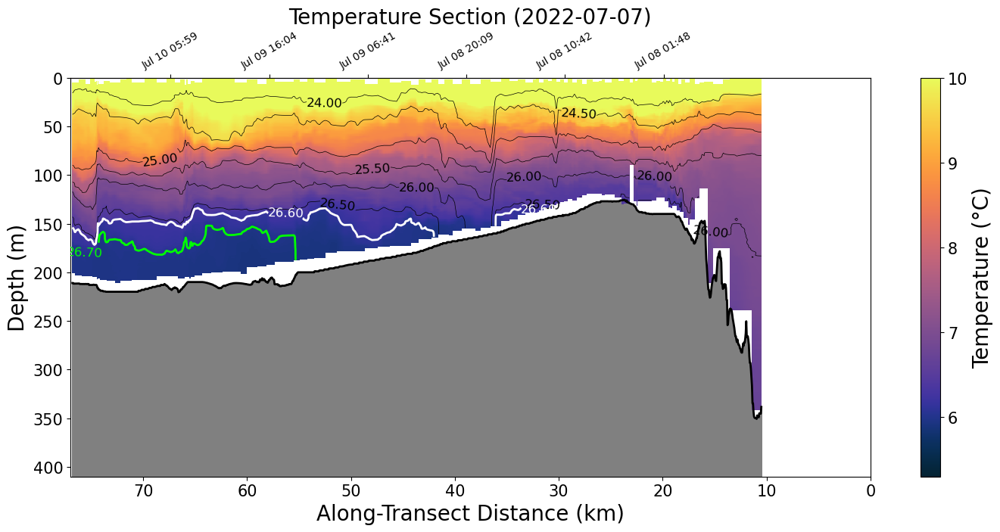

📈 Plotting: transect from 2022-07-28


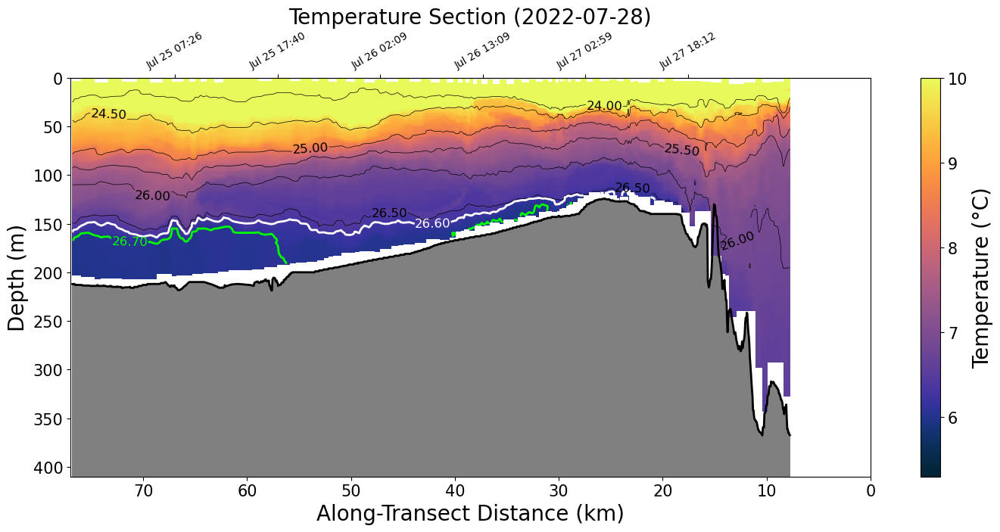

📈 Plotting: transect from 2022-09-14


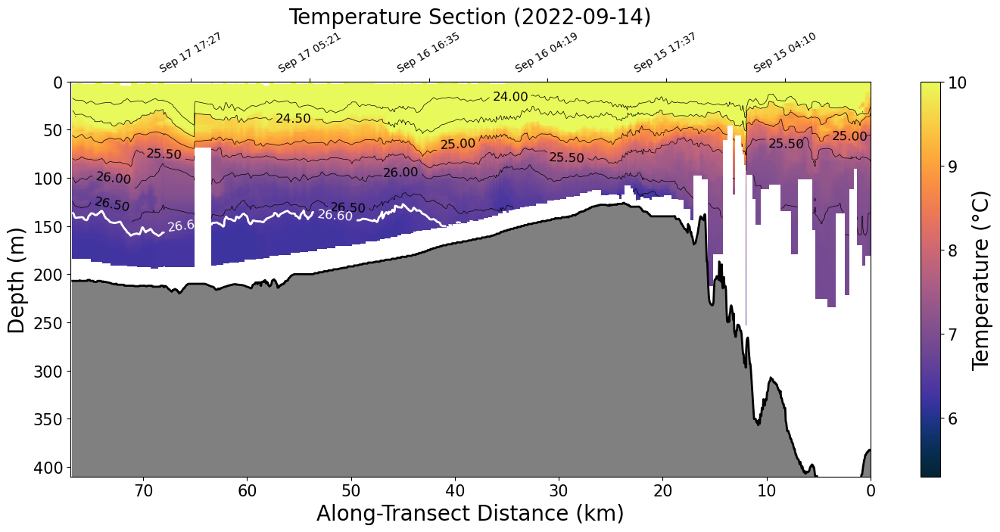

📈 Plotting: transect from 2022-10-12


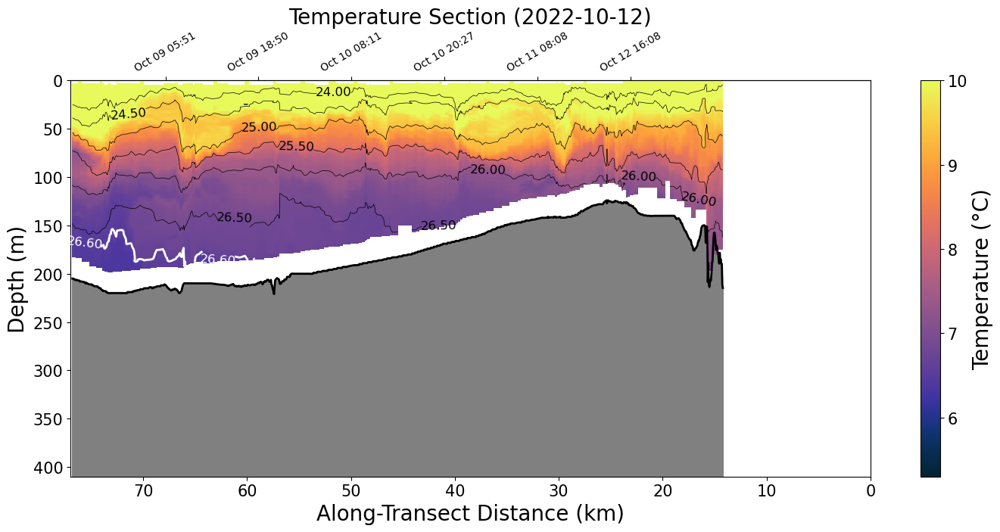

📈 Plotting: transect from 2022-10-18


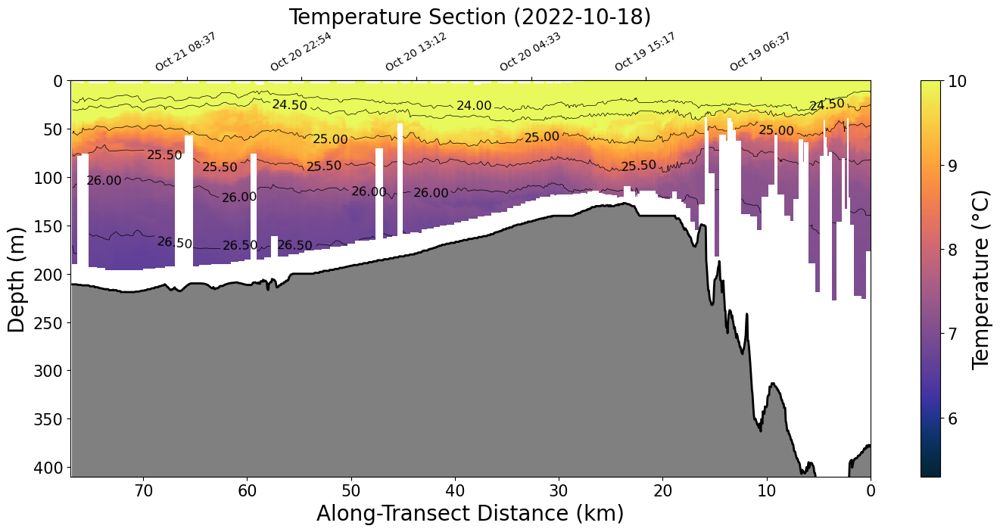

📈 Plotting: transect from 2022-11-25


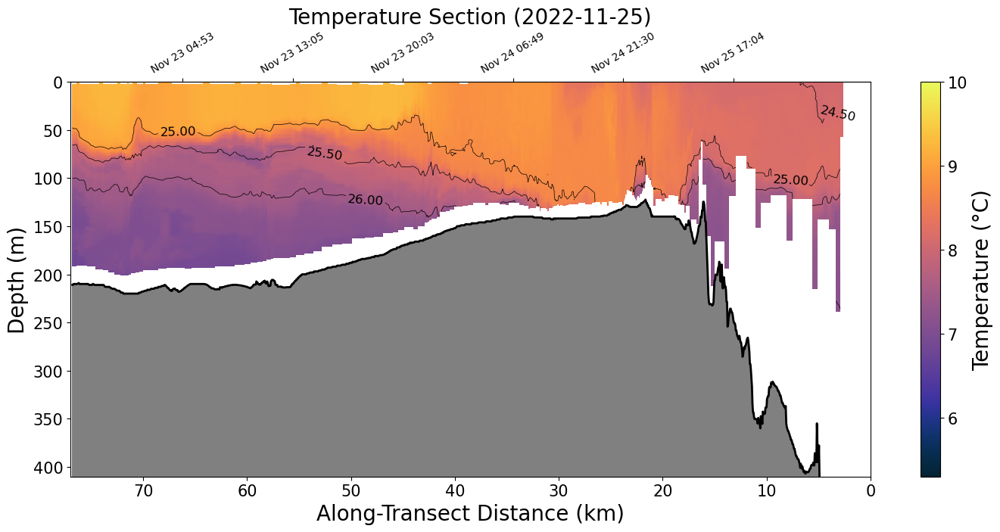

📈 Plotting: transect from 2022-11-29


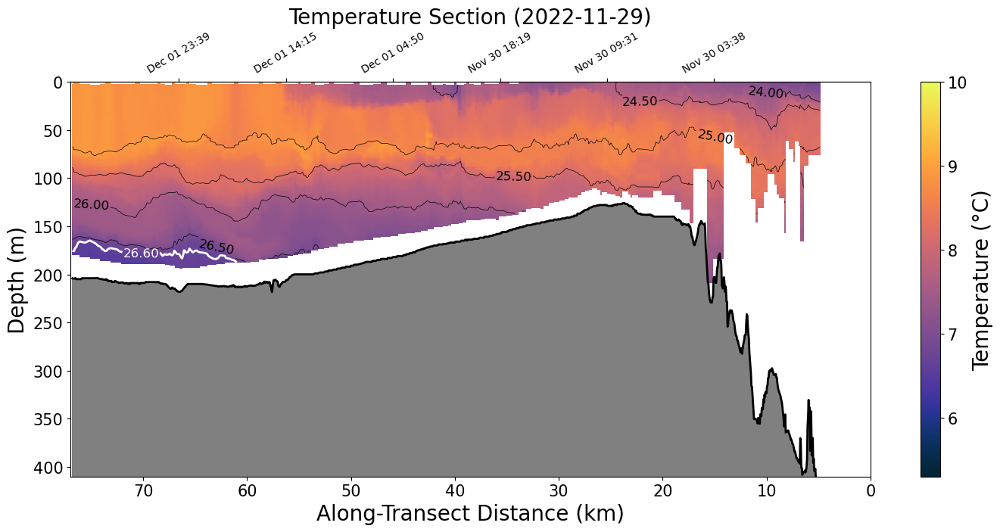

📈 Plotting: transect from 2023-03-20


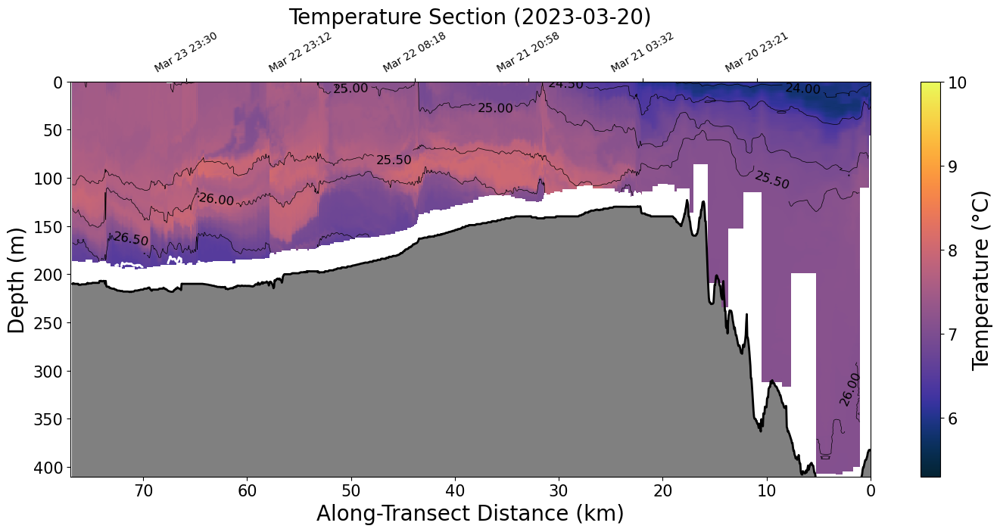

📈 Plotting: transect from 2023-04-13


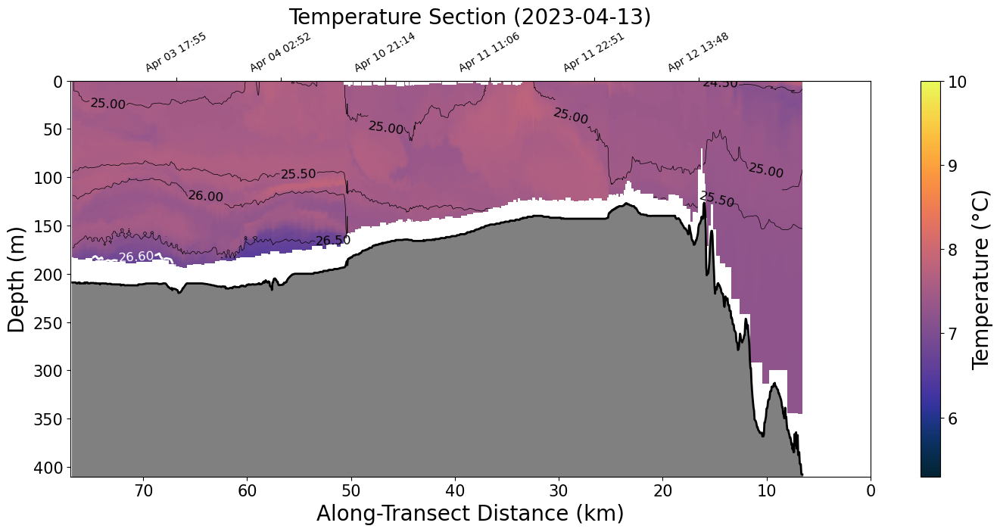

📈 Plotting: transect from 2023-04-18


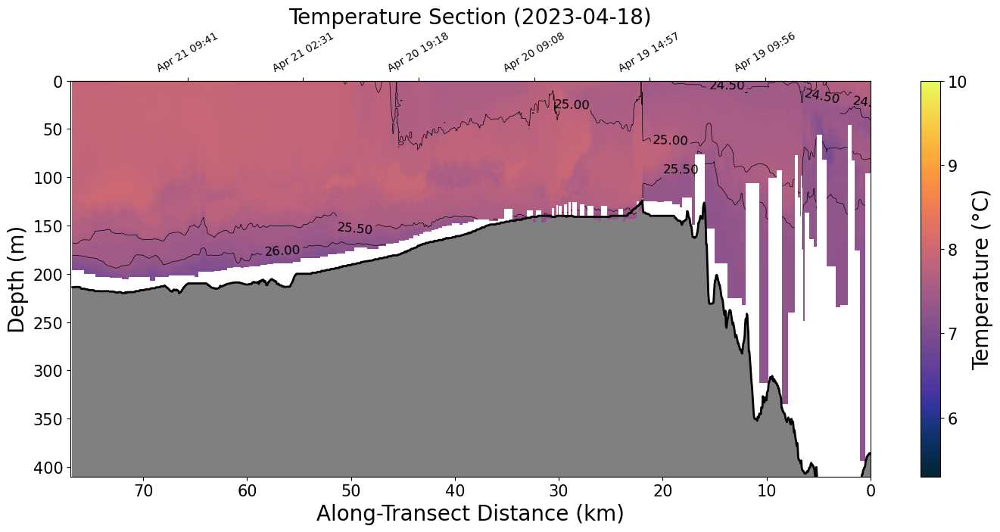

📈 Plotting: transect from 2023-05-12


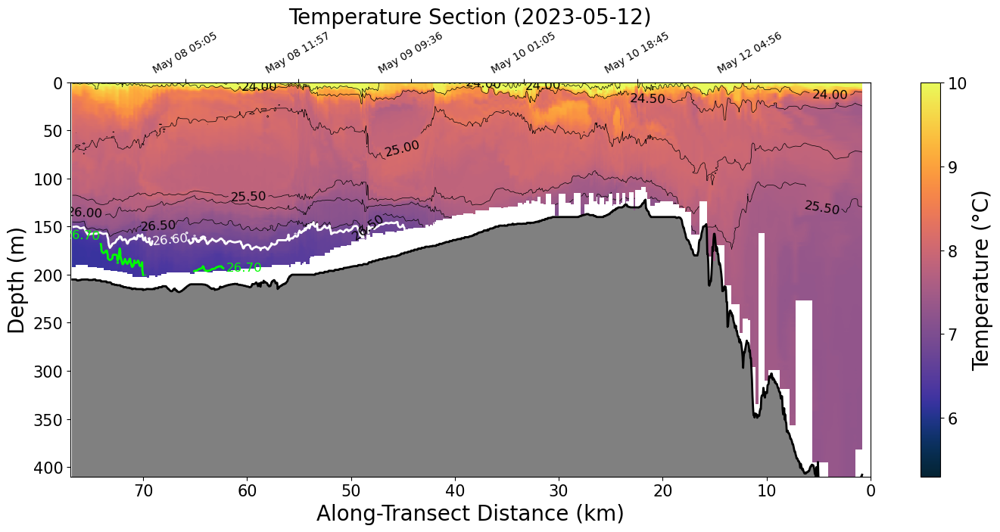

📈 Plotting: transect from 2023-05-16


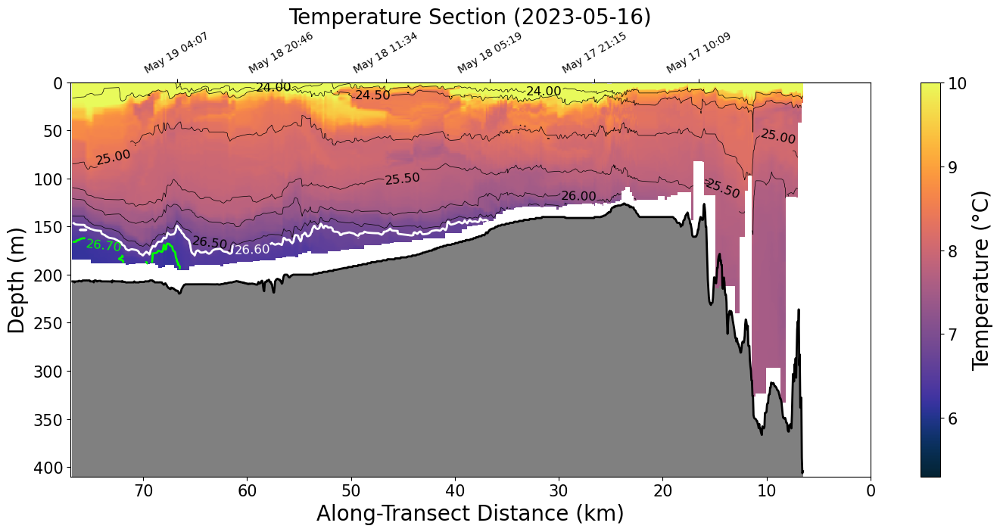

📈 Plotting: transect from 2023-05-19


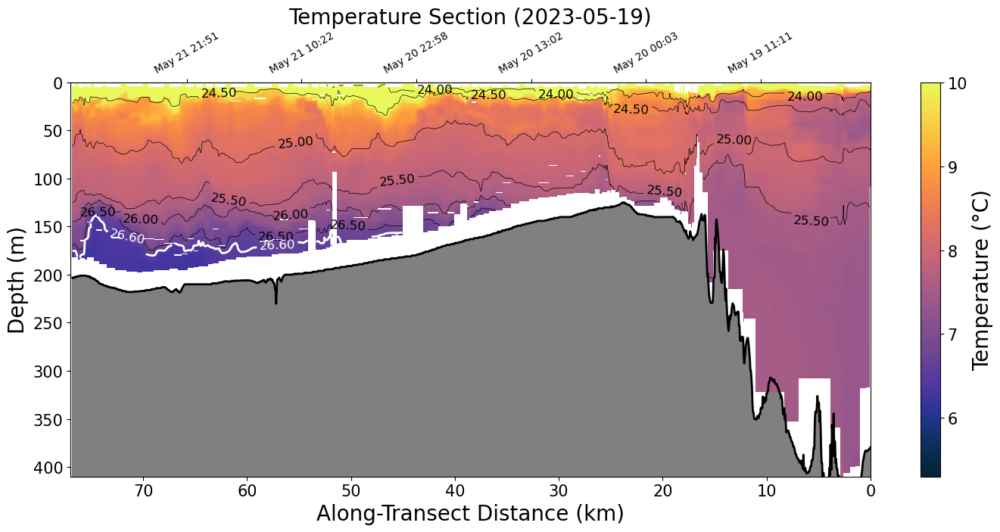

📈 Plotting: transect from 2023-06-14


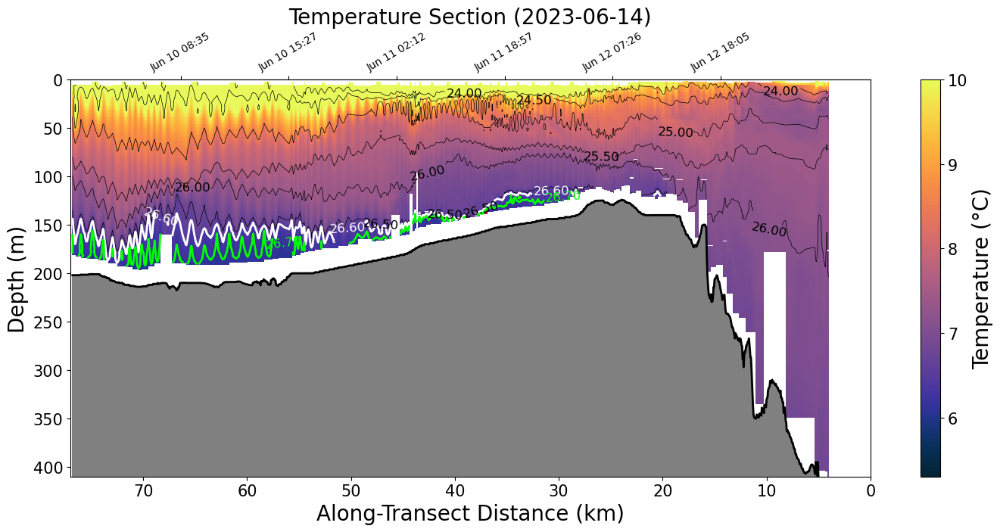

📈 Plotting: transect from 2023-06-20


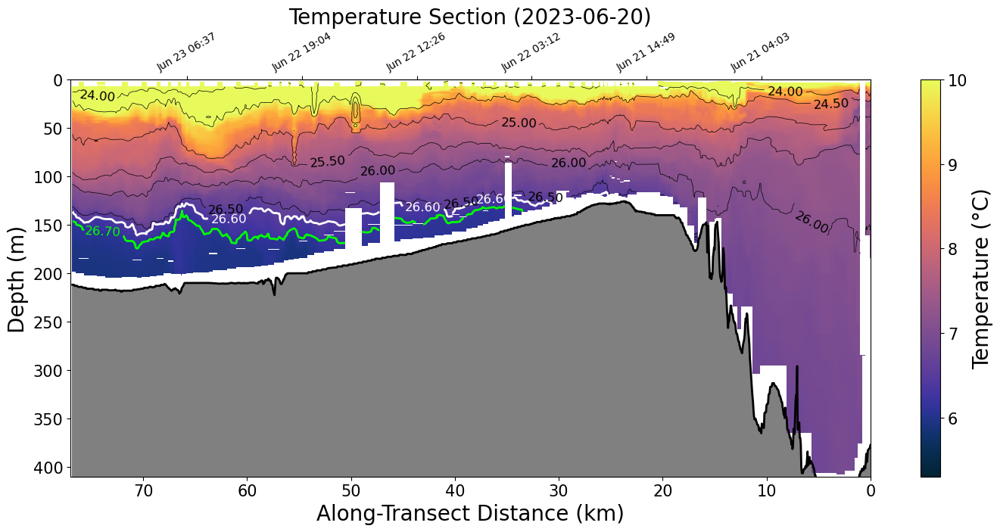

📈 Plotting: transect from 2023-07-14


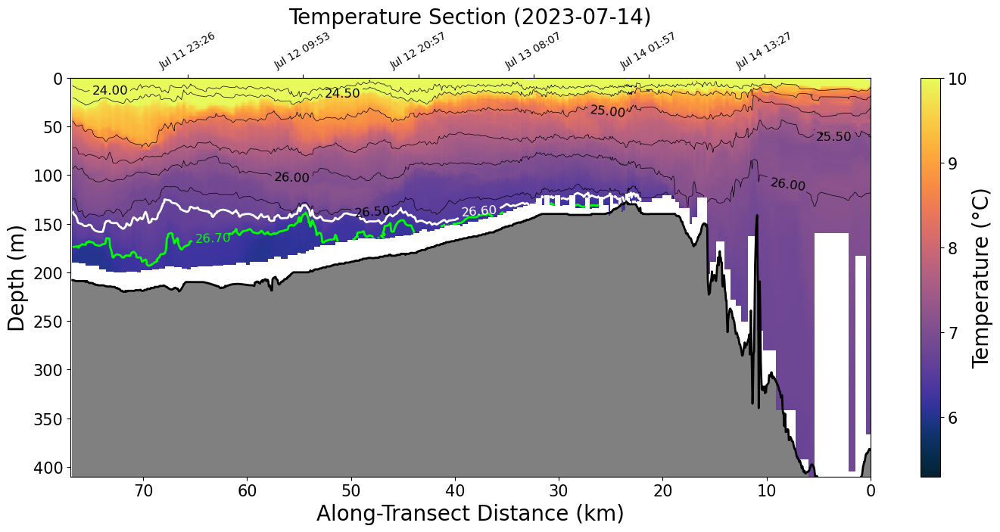

📈 Plotting: transect from 2023-07-20


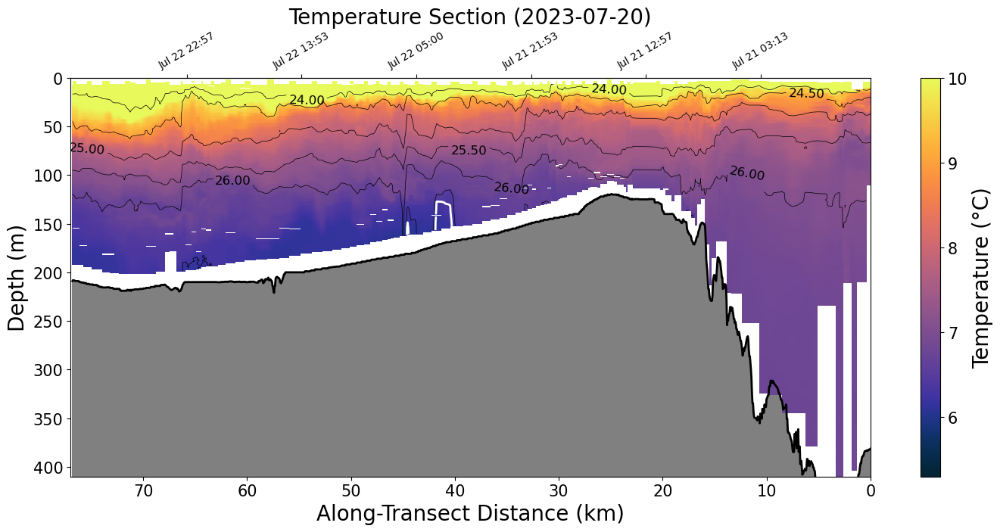

📈 Plotting: transect from 2023-07-21


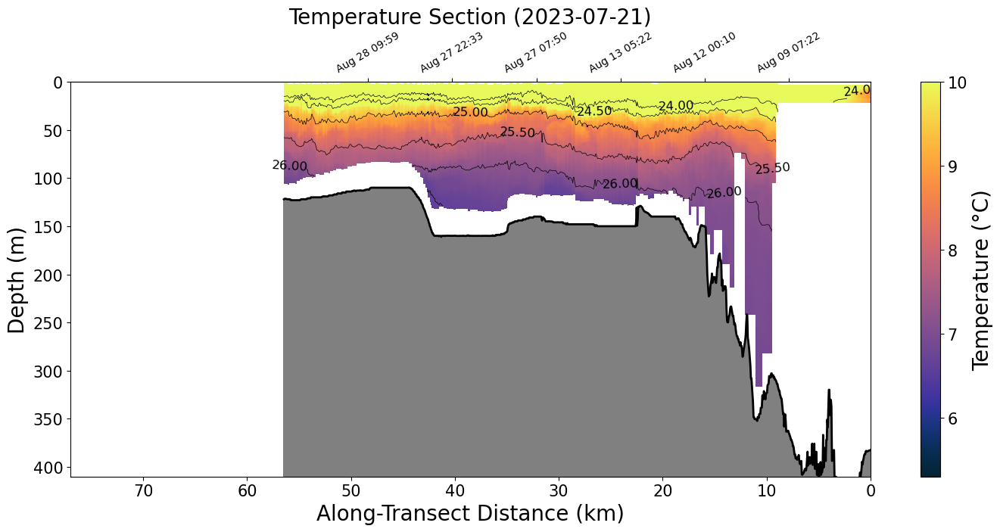

📈 Plotting: transect from 2023-08-09


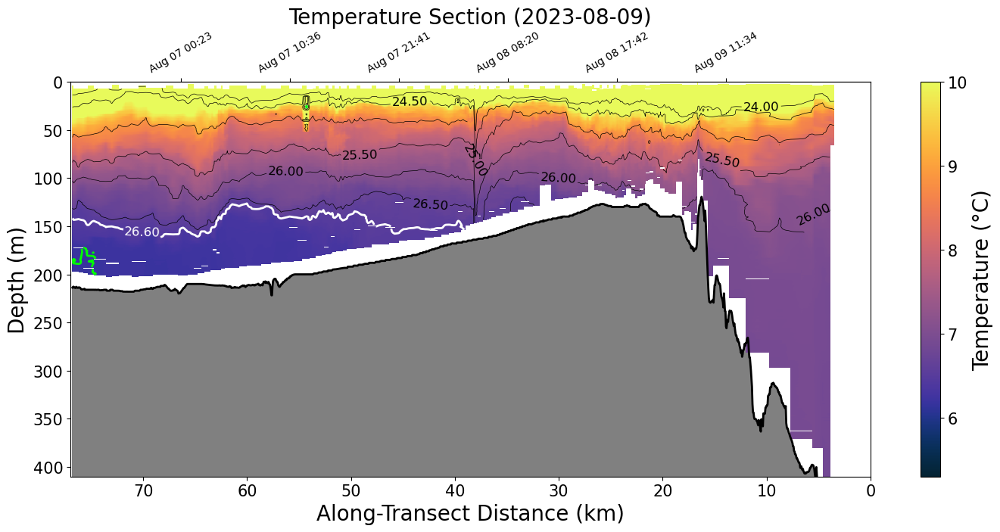

📈 Plotting: transect from 2023-08-11


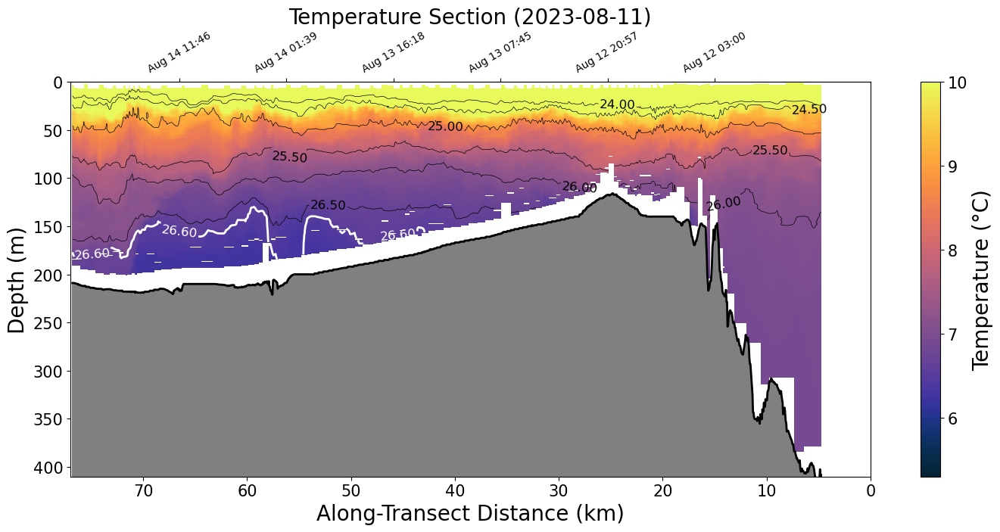

📈 Plotting: transect from 2023-09-11


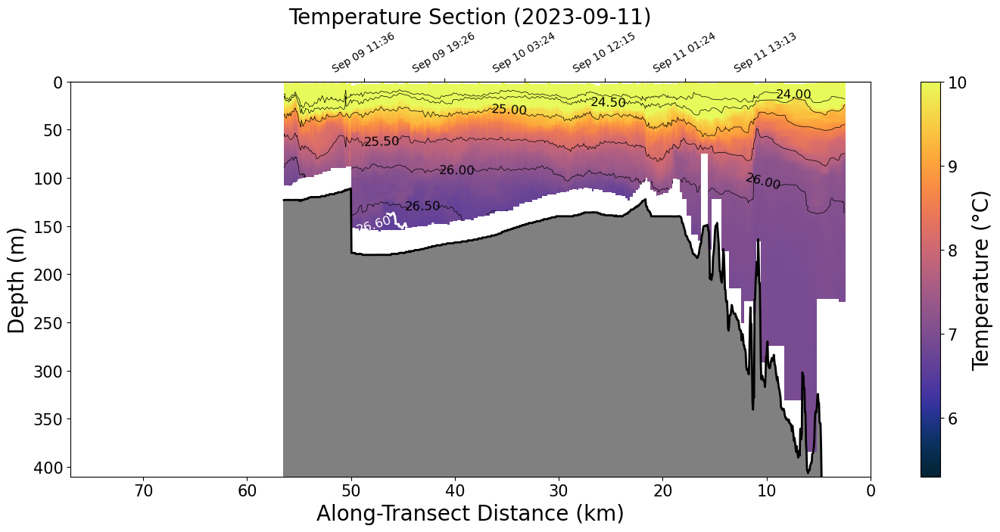

📈 Plotting: transect from 2023-09-15


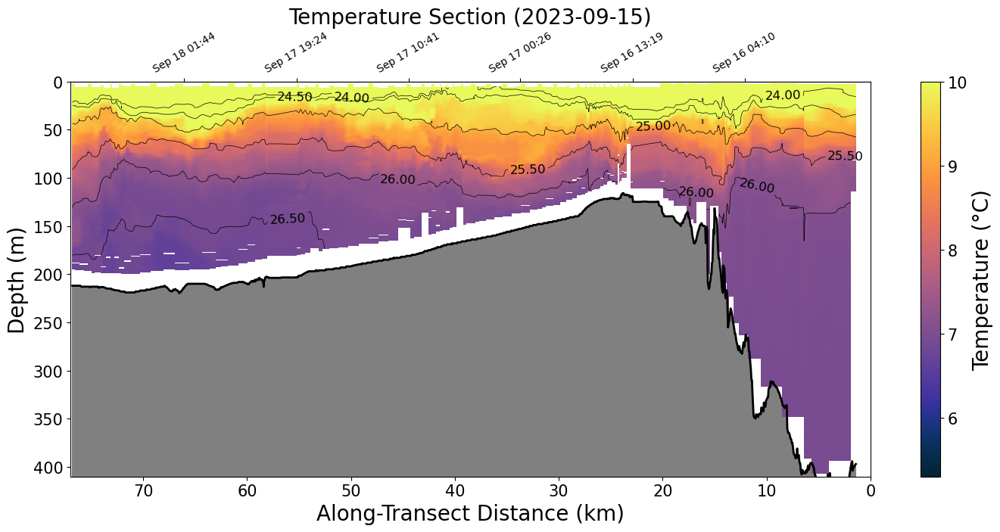

📈 Plotting: transect from 2023-10-13


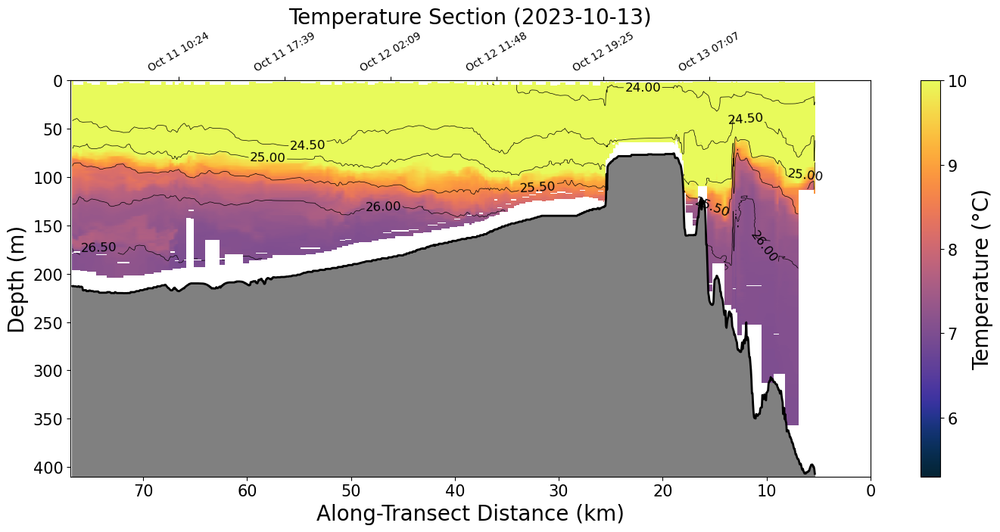

📈 Plotting: transect from 2023-10-19


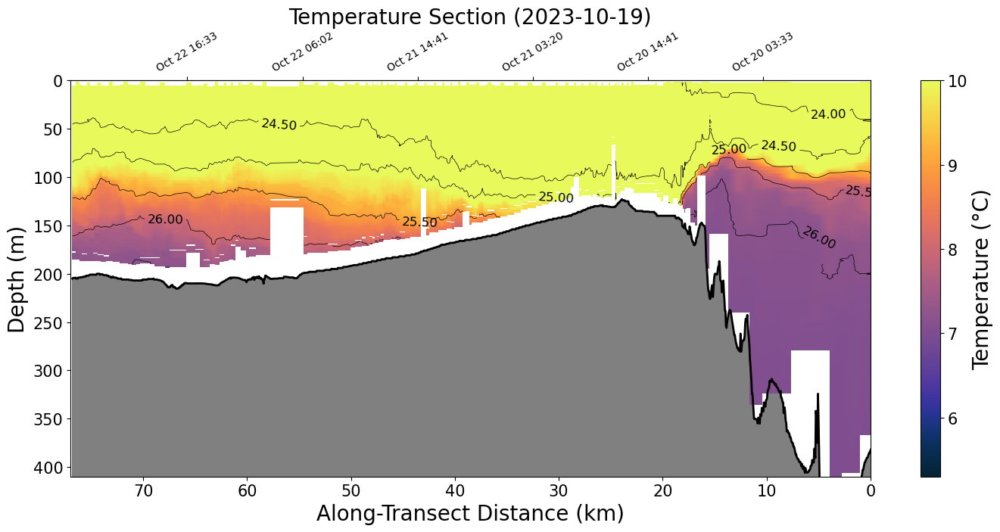

📈 Plotting: transect from 2024-03-12


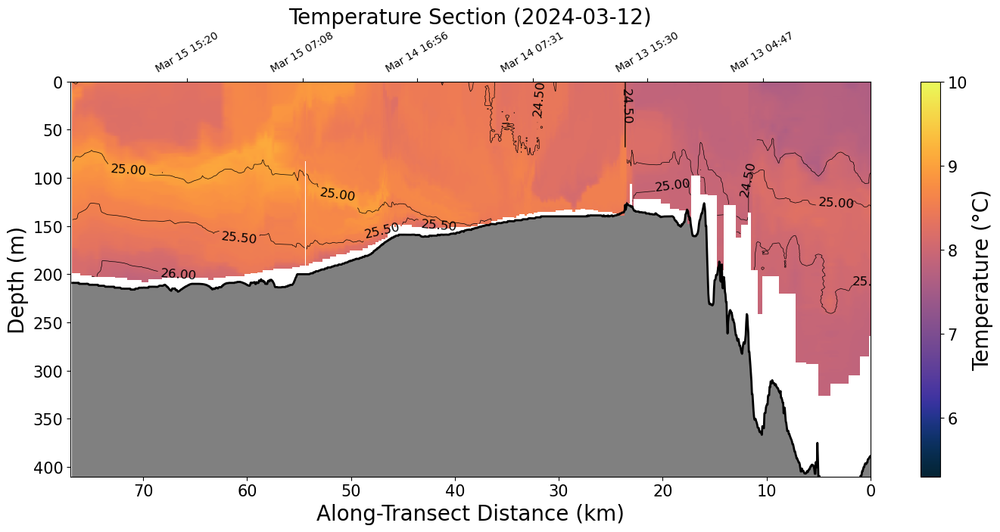

📈 Plotting: transect from 2024-04-16


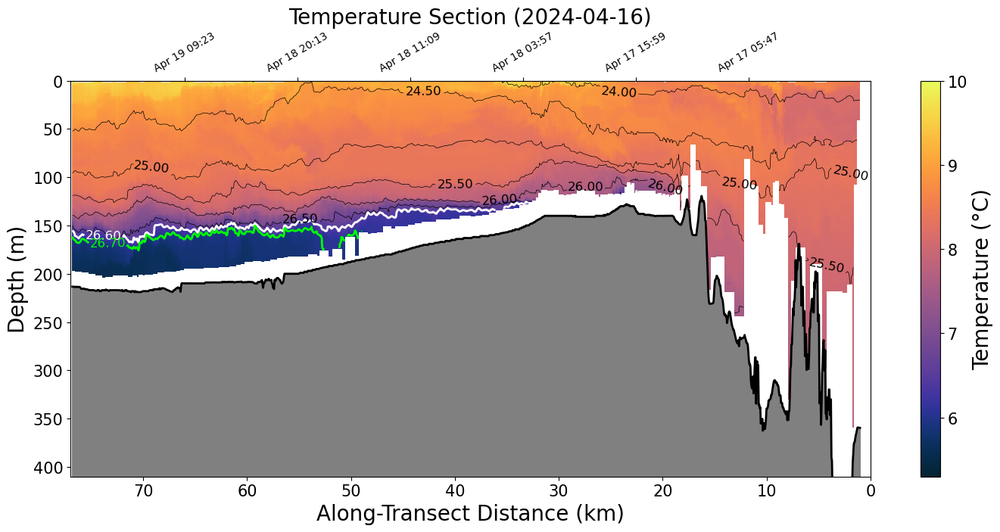

📈 Plotting: transect from 2024-05-10


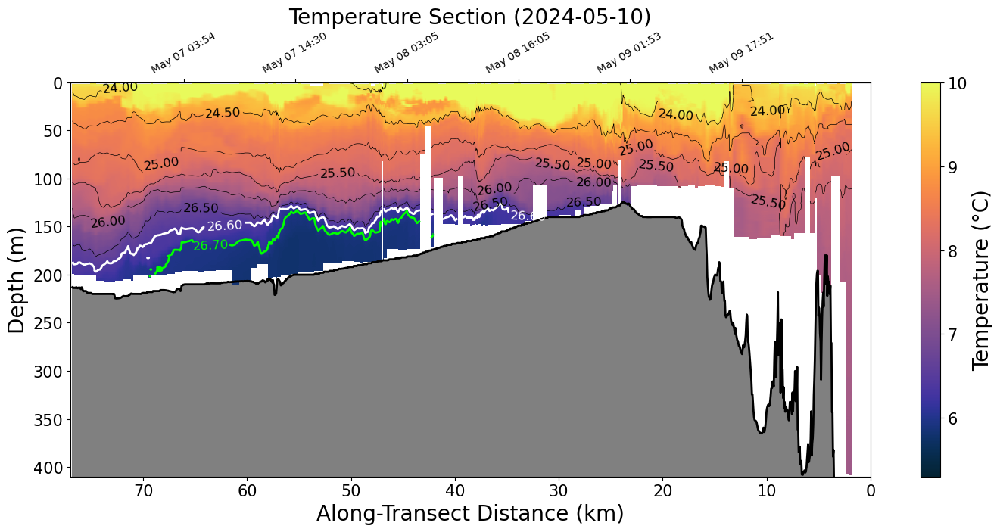

📈 Plotting: transect from 2024-05-16


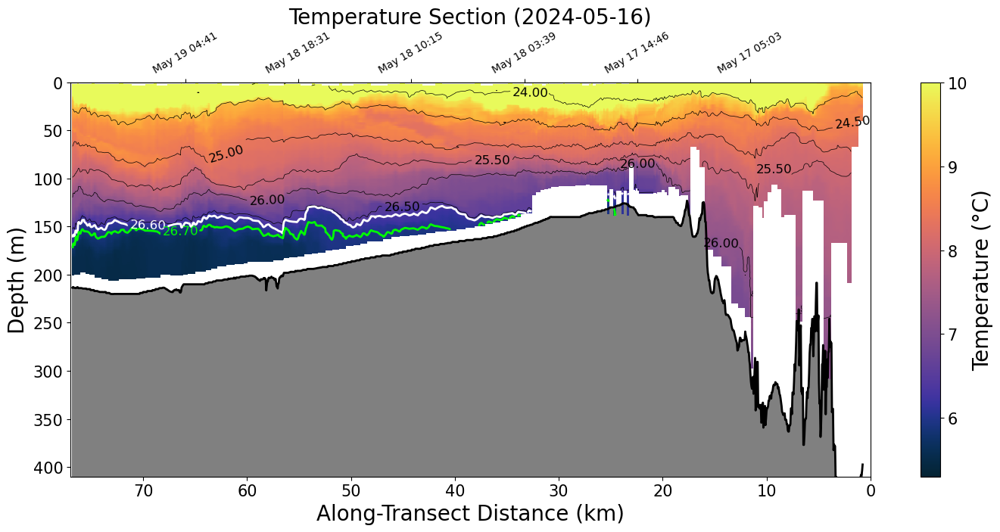

📈 Plotting: transect from 2024-07-17


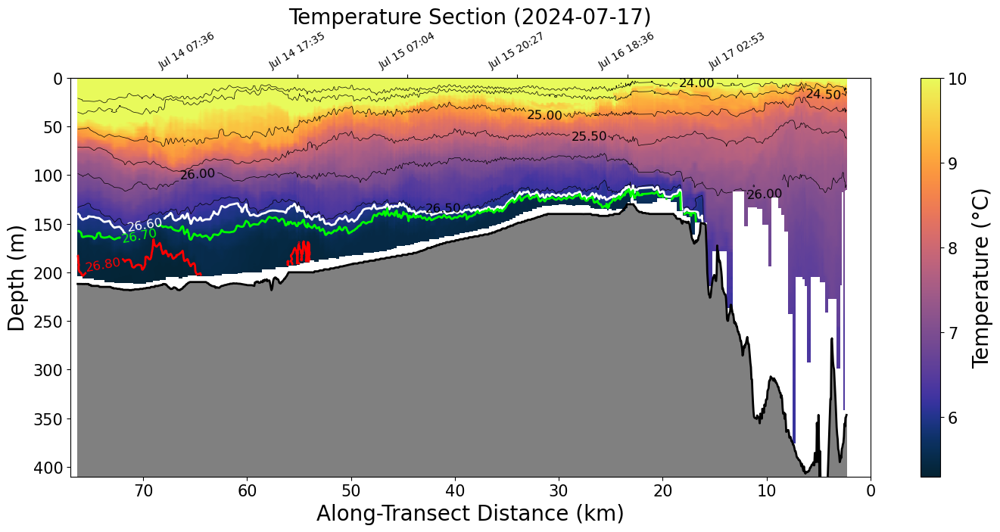

📈 Plotting: transect from 2024-07-23


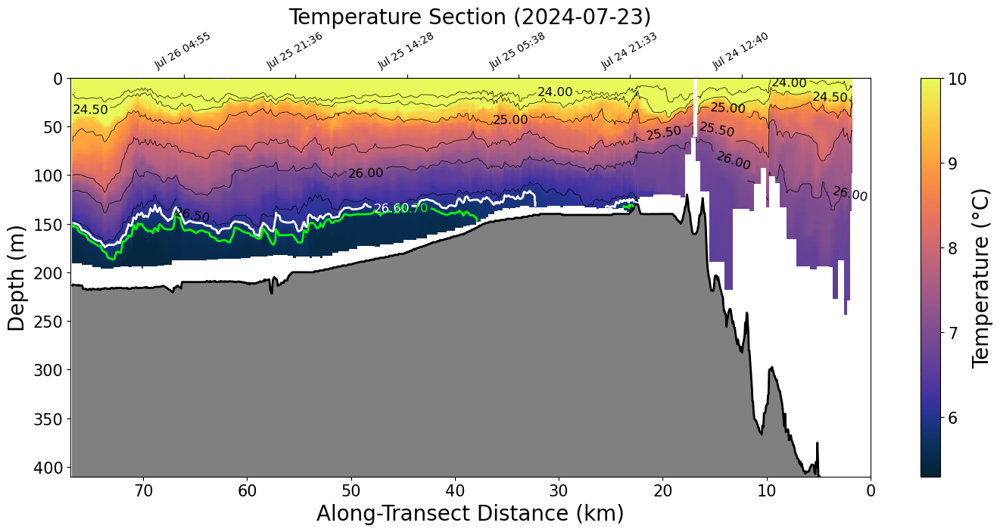

📈 Plotting: transect from 2024-09-18


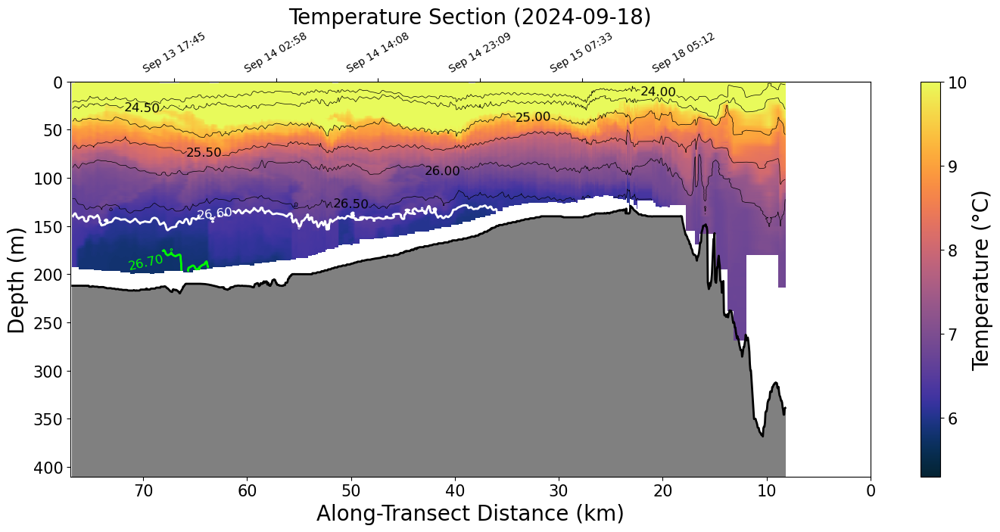

📈 Plotting: transect from 2024-09-24


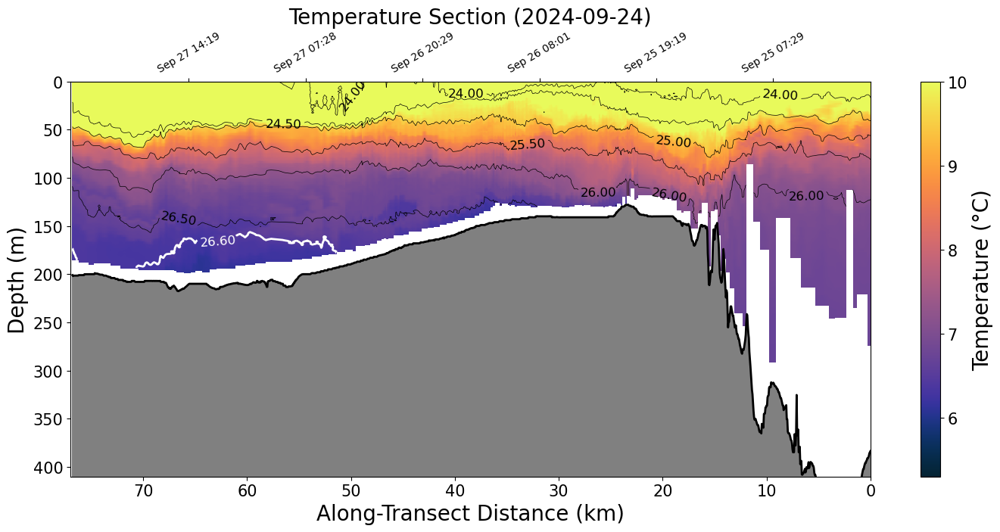

📈 Plotting: transect from 2024-11-14


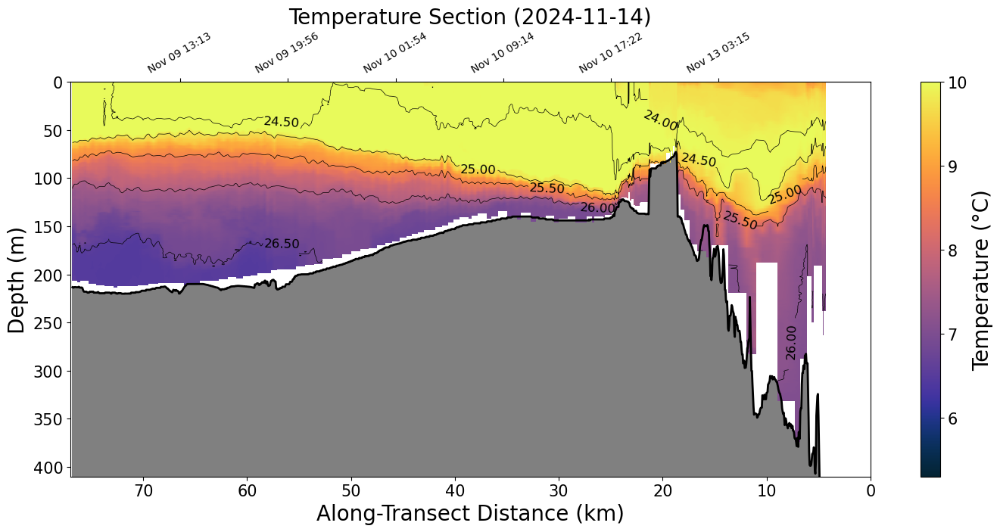

📈 Plotting: transect from 2024-11-19


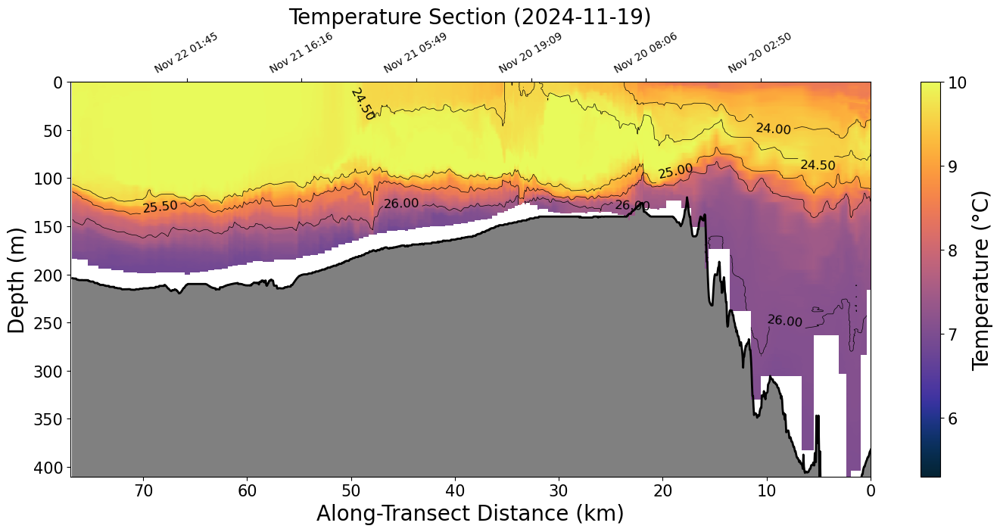

📈 Plotting: transect from 2025-01-09


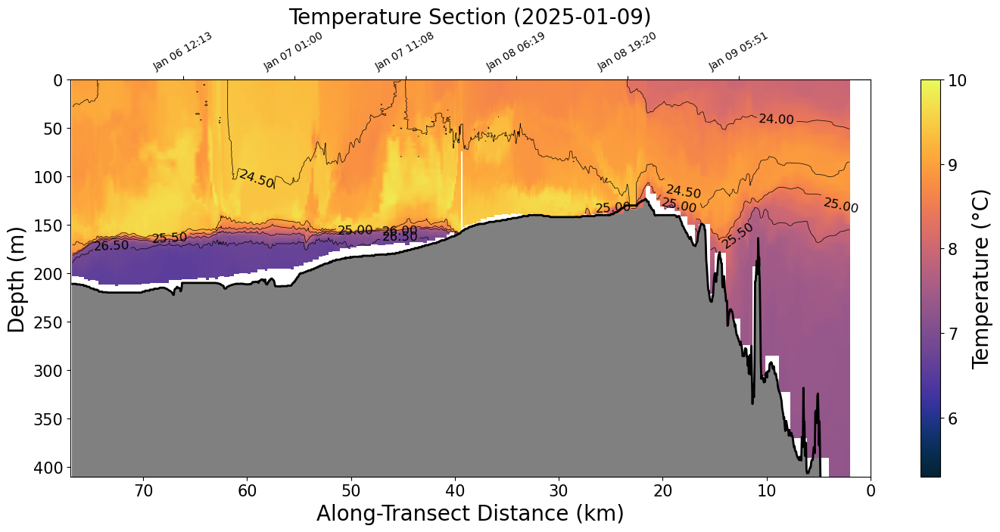

📈 Plotting: transect from 2025-01-14


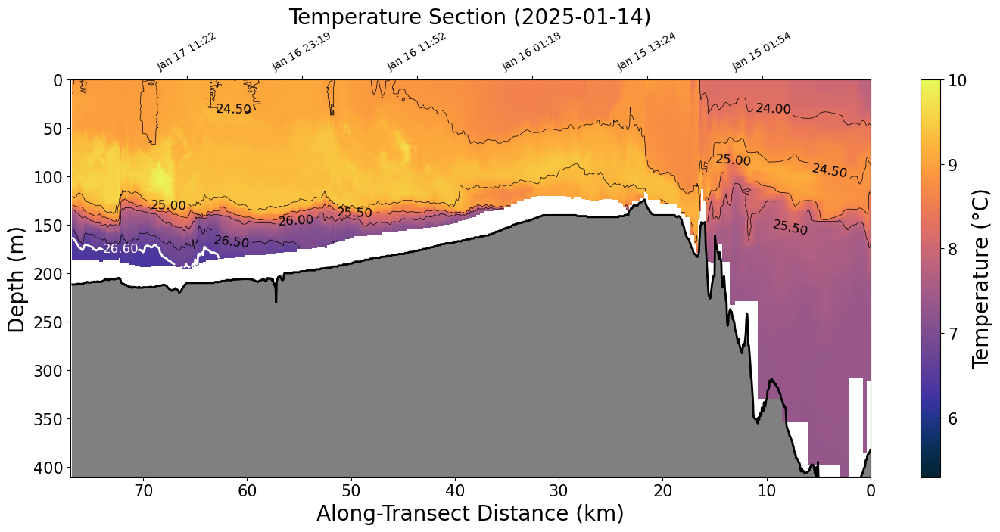

📈 Plotting: transect from 2025-03-12


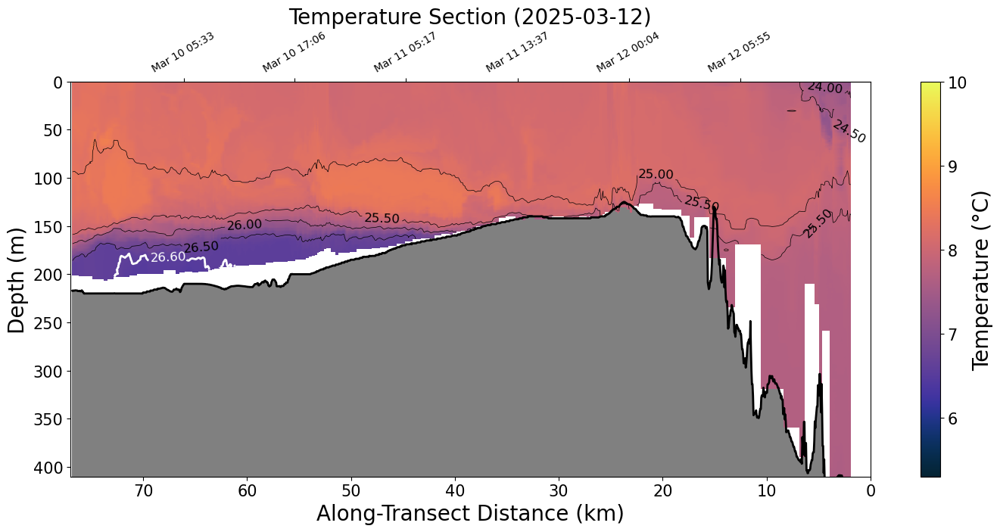

📈 Plotting: transect from 2025-04-30


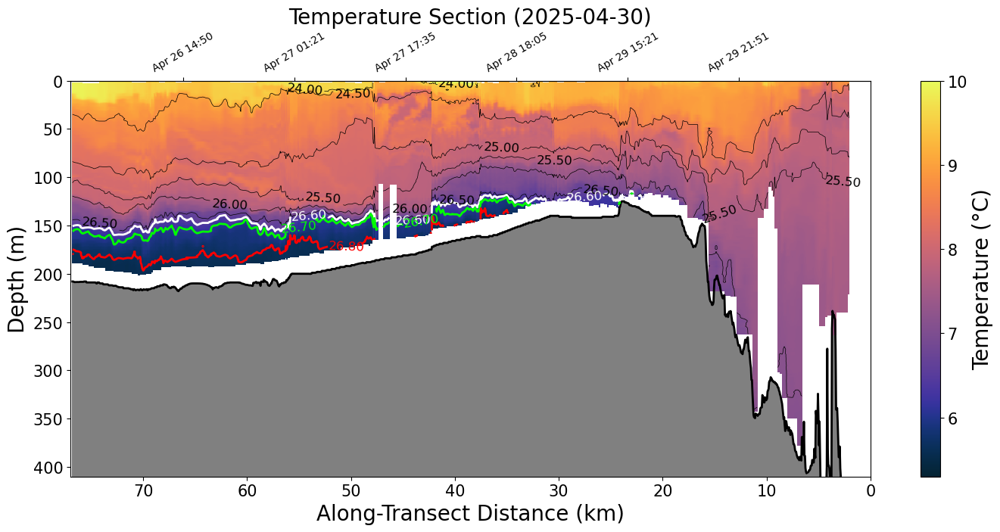

In [3]:
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
import os
import matplotlib.dates as mdates
import cmocean as cm
import waypoint_distance as wd
import pandas as pd

directory = os.path.expanduser('~/Desktop/cleaned_transects')
all_files = sorted([
    os.path.join(directory, f) for f in os.listdir(directory)
    if f.endswith('.nc')
])

# Extract transect times for sorting without loading all datasets
file_times = []
for file in all_files:
    try:
        ds = xr.open_dataset(file)
        valid_times = ds['time'].values[~np.isnan(ds['time'].values)]
        if len(valid_times) == 0:
            print(f"⚠️ Skipping {os.path.basename(file)} — no valid timestamps found.")
            continue
        transect_time = pd.to_datetime(valid_times[0])
        file_times.append((file, transect_time))
        ds.close()
    except Exception as e:
        print(f"❌ Error loading {file}: {e}")

# Sort file list by extracted transect_time
file_times.sort(key=lambda x: x[1])

# Now process and plot one by one
for file, transect_time in file_times:
    print(f"📈 Plotting: transect from {transect_time.strftime('%Y-%m-%d')}")
    ds = xr.open_dataset(file)

    # Assign transect_time if not already present
    if 'transect_time' not in ds:
        ds = ds.assign(transect_time=('transect', [transect_time]))

    plot_all_sections(ds)
    plt.show()

    # Optionally close the dataset explicitly
    ds.close()

In [6]:
file_pathway = '~/Desktop/cleaned_transects/dfo-eva035-20230811_grid_delayed_out.nc'
ds = xr.open_dataset(file_pathway)
ds

<xarray.Dataset> Size: 229MB
Dimensions:                (depth: 1100, along: 1444, transect: 1)
Coordinates:
  * depth                  (depth) float64 9kB 0.5 1.5 2.5 ... 1.098e+03 1.1e+03
    profile                (along) float64 12kB ...
    longitude              (along) float64 12kB ...
    latitude               (along) float64 12kB ...
  * along                  (along) float64 12kB 4.7e+03 4.75e+03 ... 7.685e+04
  * transect               (transect) int64 8B 16
Data variables: (12/21)
    heading                (transect, depth, along) float64 13MB ...
    pitch                  (transect, depth, along) float64 13MB ...
    roll                   (transect, depth, along) float64 13MB ...
    conductivity           (transect, depth, along) float64 13MB ...
    temperature            (transect, depth, along) float64 13MB ...
    pressure               (transect, depth, along) float64 13MB ...
    ...                     ...
    potential_density      (transect, depth, along) float64 13MB ...
    density                (transect, depth, along) float64 13MB ...
    potential_temperature  (transect, depth, along) float64 13MB ...
    mission_number         (transect) int32 4B ...
    across                 (transect, along) float64 12kB ...
    time                   (transect, along) datetime64[ns] 12kB ...
Attributes: (12/65)
    Conventions:               CF-1.8
    Metadata_Conventions:      CF-1.6, Unidata Dataset Discovery v1.0
    acknowledgement:           Funding from Fisheries and Oceans Canada, Cana...
    comment:                   Calvert Island deployment
    contributor_name:          James Pegg, Jody Klymak, Tetjana Ross, Hayley ...
    contributor_role:          Lead Technician, Principal Investigator, Co-PI...
    ...                        ...
    summary:                   Glider deployed near Calvert Island BC as part...
    time_coverage_end:         2023-09-11T23:17:46
    time_coverage_start:       2023-08-11T14:38:30
    title:                     dfo-eva035-20230811T1438
    transmission_system:       IRIDIUM
    wmo_id:                    4803917

In [13]:
def plot_mission(ds, lat_bounds=None, lon_bounds=None):
    """
    Plot a single glider path over bathymetry for the Calvert Line.

    Parameters:
    - file_path: str, optional, used to extract mission name
    - lon_bounds, lat_bounds: optional bounds for plotting
    """
    
    topo_file=os.path.expanduser('~/Desktop/british_columbia_3_msl_2013.nc')

    # Extract lon/lat
    lons = ds['longitude'].values
    lats = ds['latitude'].values
    time_vals = ds['time'].values
    time_nums = mdates.date2num(time_vals)

    # Auto bounds if not provided
    if lon_bounds is None:
        lon_bounds = [lons.min() - 0.5, lons.max() + 0.5]
    if lat_bounds is None:
        lat_bounds = [lats.min() - 0.5, lats.max() + 0.5]

    # Load topo data
    topo = xr.open_dataset(topo_file)
    topo = topo.sel(
        lon=slice(lon_bounds[0], lon_bounds[1]),
        lat=slice(lat_bounds[0], lat_bounds[1]))

    # Set up plot
    fig, ax = plt.subplots(figsize=(12, 9), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.set_extent(lon_bounds + lat_bounds, crs=ccrs.PlateCarree())
    gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0)
    gl.top_labels = False
    gl.right_labels = False

    # Plot bathymetry
    topo_var = -topo['Band1']
    levels = np.linspace(0, 410, 51)
    contourf = ax.contourf(topo['lon'], topo['lat'], topo_var,
                           levels=levels, cmap=cm.cm.deep, extend='both')
    fig.colorbar(contourf, ax=ax, label='Depth (m)')

    # Add 0 m elevation contour in black
    ax.contour(topo['lon'], topo['lat'], topo_var, levels=[0.5], colors='black', linewidths=1)

    # Plot glider track
    sc = ax.scatter(lons, lats, c=time_nums, cmap='seismic',
                    vmin=time_nums.min(), vmax=time_nums.max(),
                    s=5, transform=ccrs.PlateCarree(), label='Filtered Track')
    cbar = fig.colorbar(sc, ax=ax, orientation='vertical', extend='both')
    cbar.set_label('Date')
    cbar.ax.yaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))

    # Title
    if file_pathway:
        mission_name = os.path.basename(file_pathway).split('_')[0]
        ax.set_title(f'Cleaned Glider Mission Track – {mission_name}', fontsize=14)
    else:
        ax.set_title('Cleaned Glider Mission Track', fontsize=14)

    plt.tight_layout()

# Load topo data
topo_file=os.path.expanduser('~/Desktop/british_columbia_3_msl_2013.nc')
topo = xr.open_dataset(topo_file)


/var/folders/w3/xmmx3z314913xcdb0jf7m8h40000gn/T/ipykernel_1369/275842567.py:4: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  transect_indices = list(range(cube.dims['transect']))
/var/folders/w3/xmmx3z314913xcdb0jf7m8h40000gn/T/ipykernel_1369/275842567.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(12, 9), subplot_kw={'projection': ccrs.PlateCarree()})


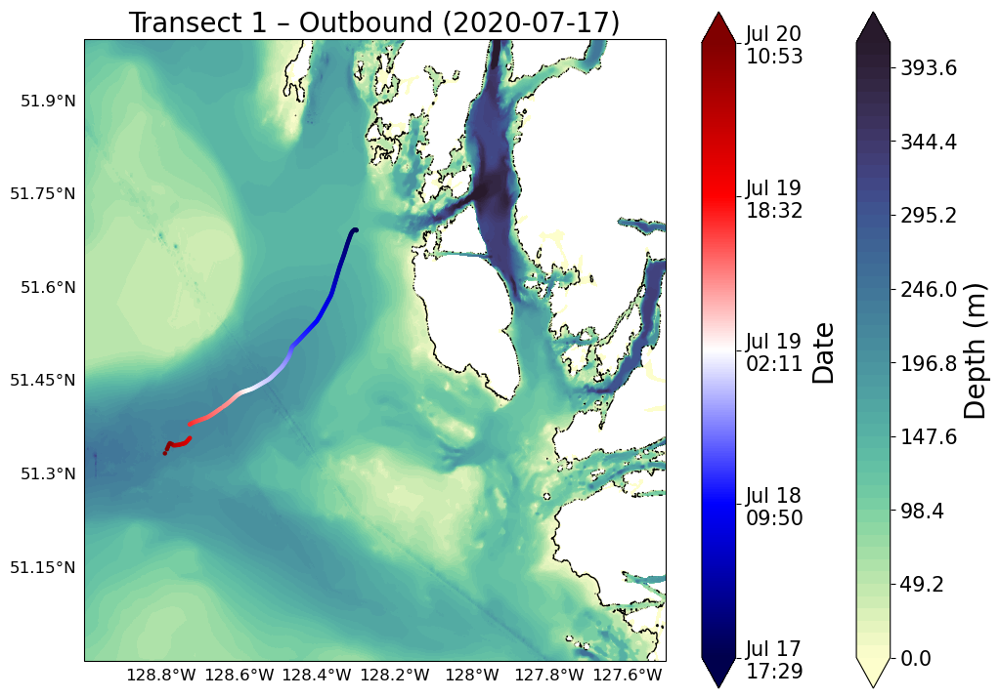

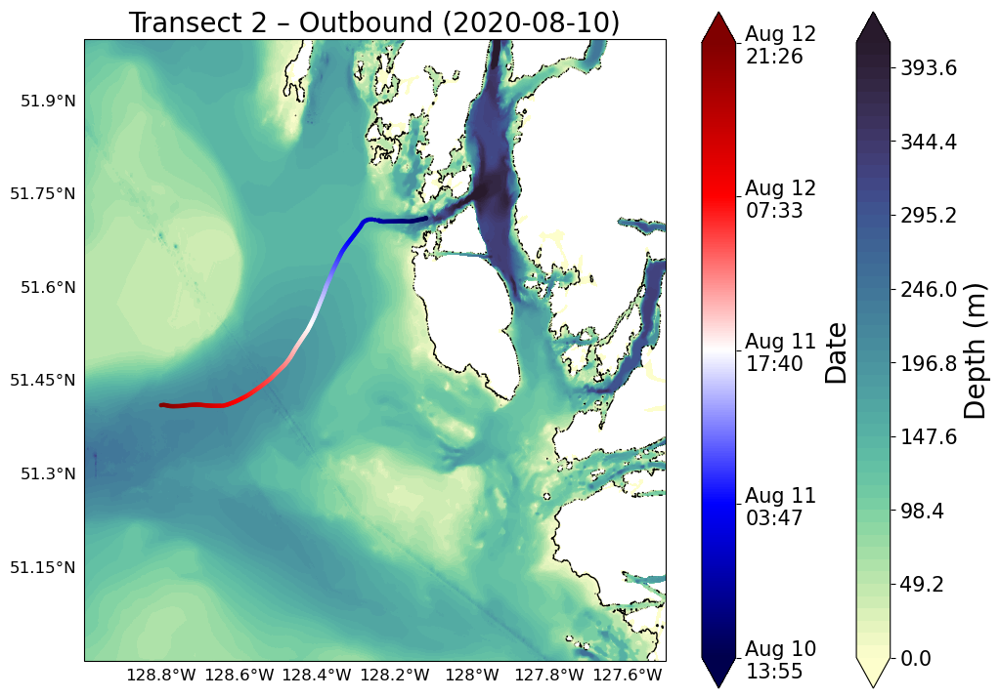

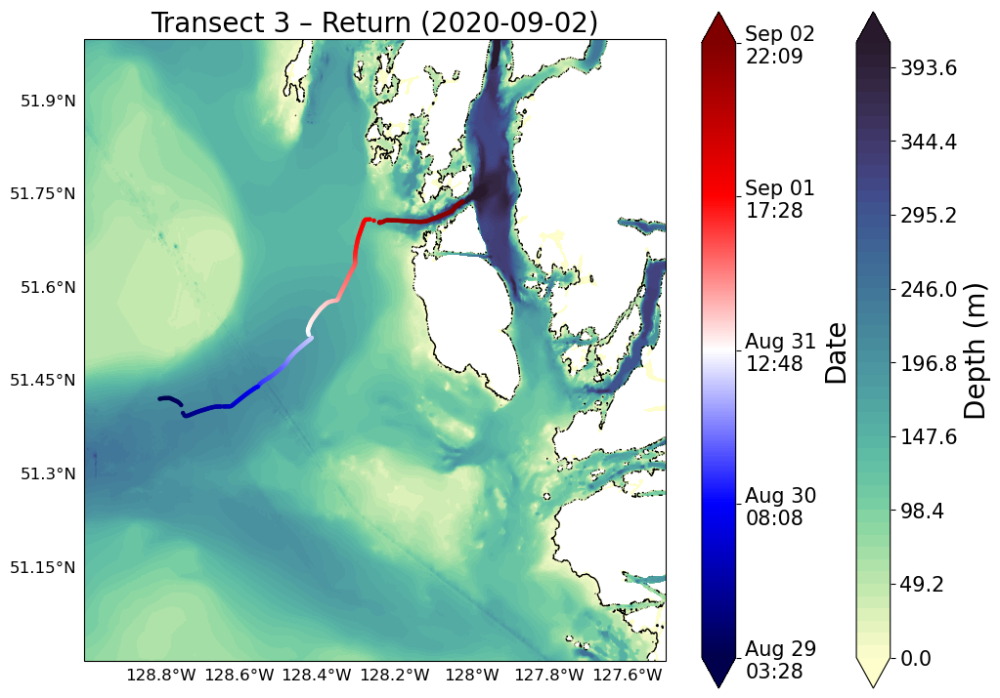

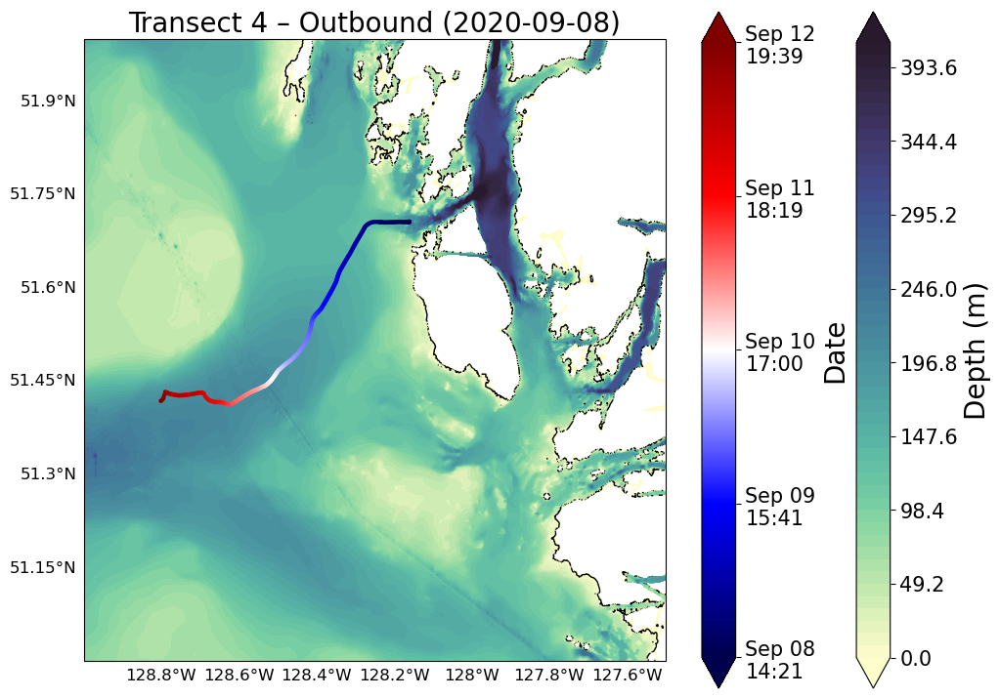

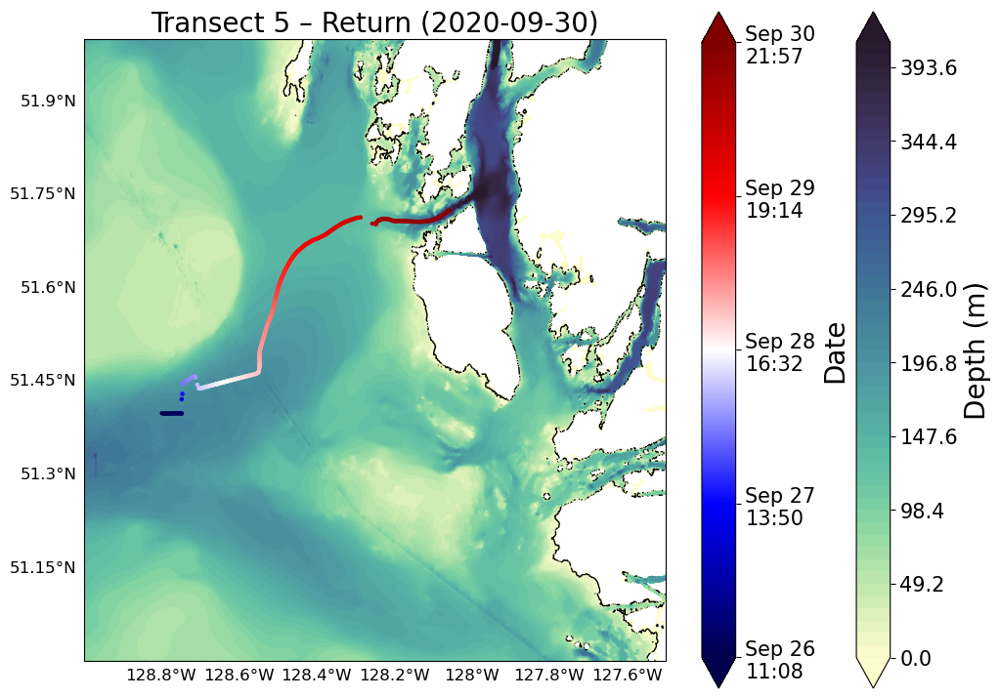

...

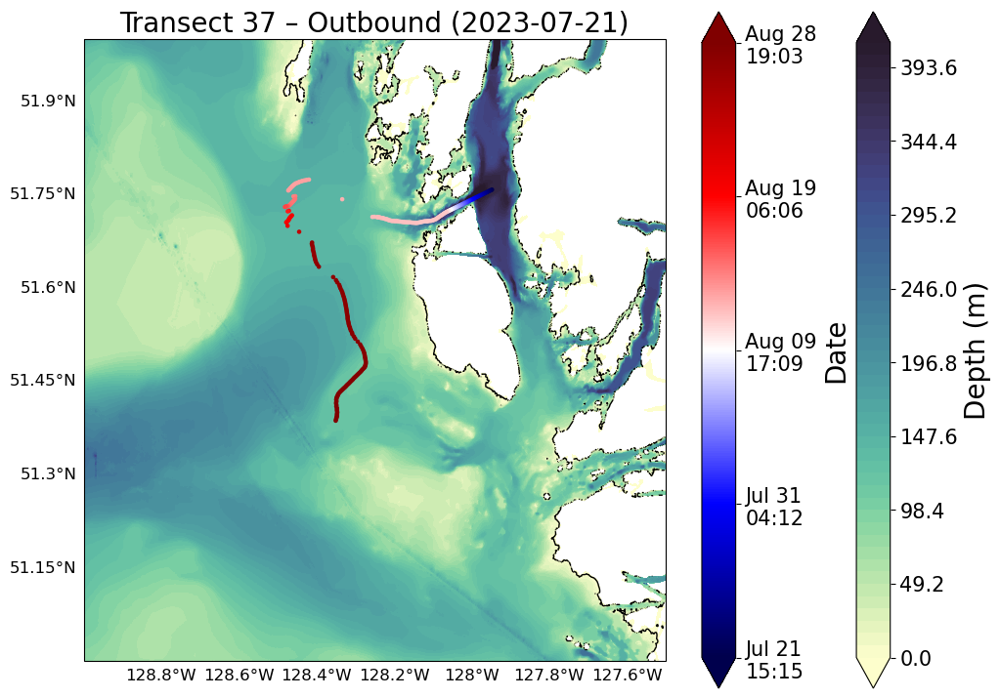

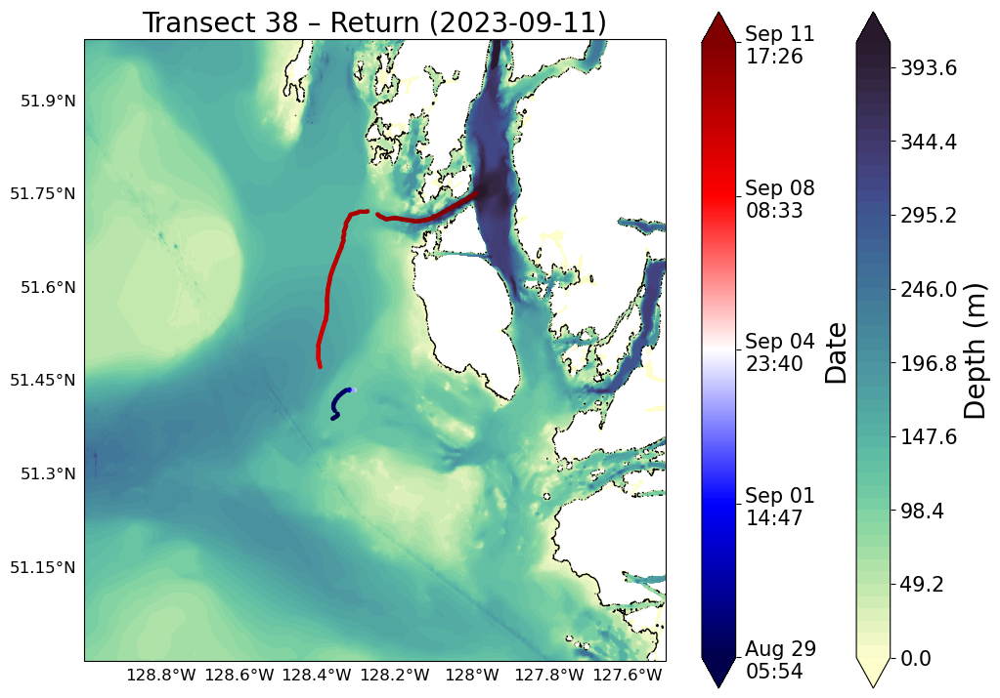

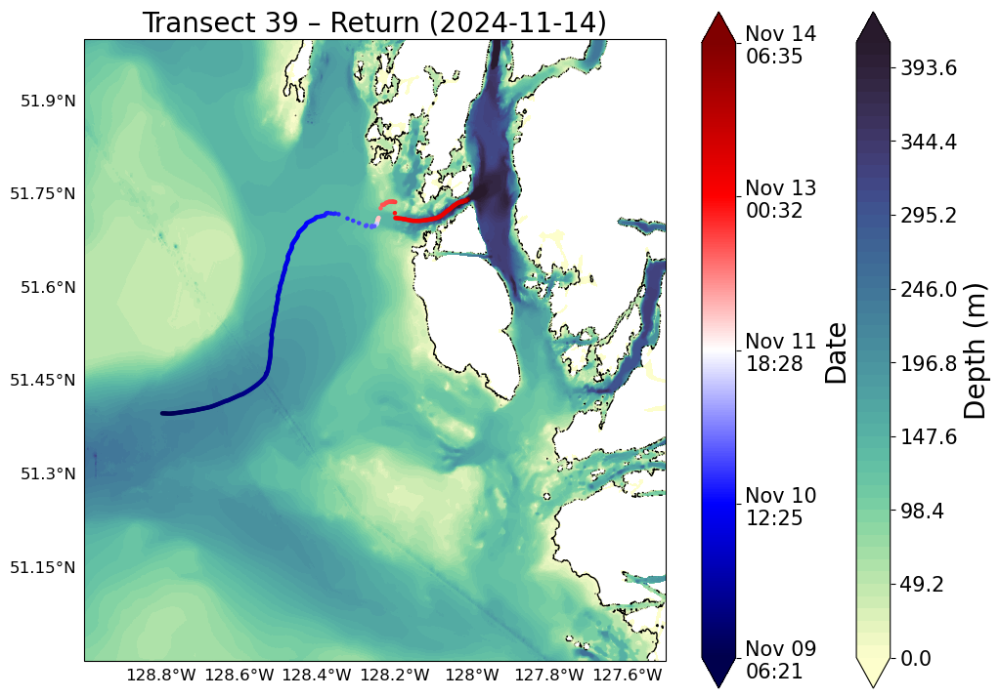

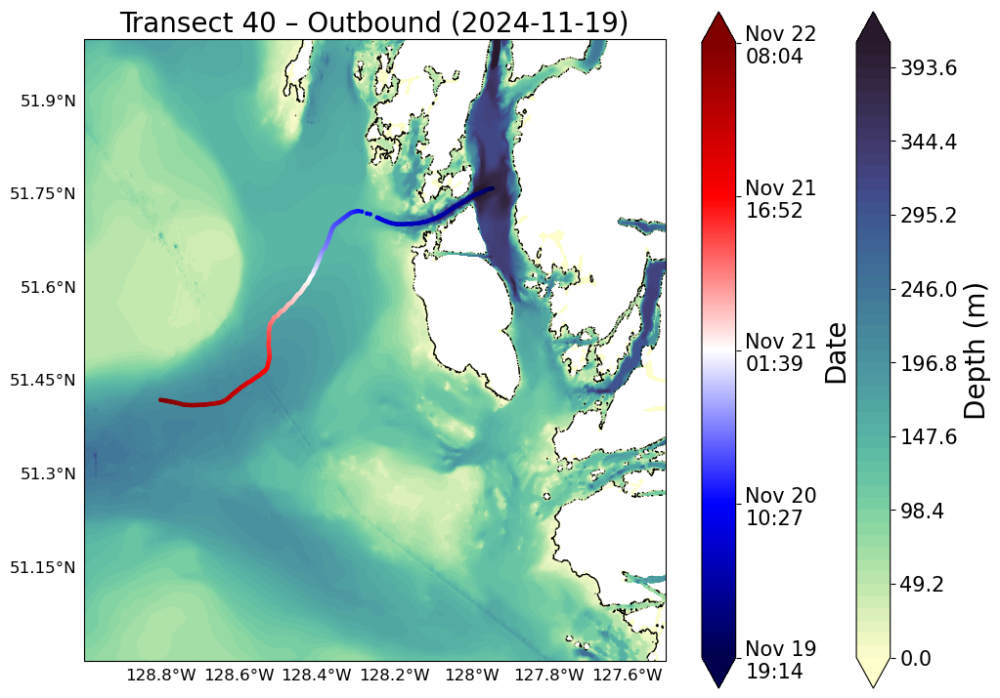

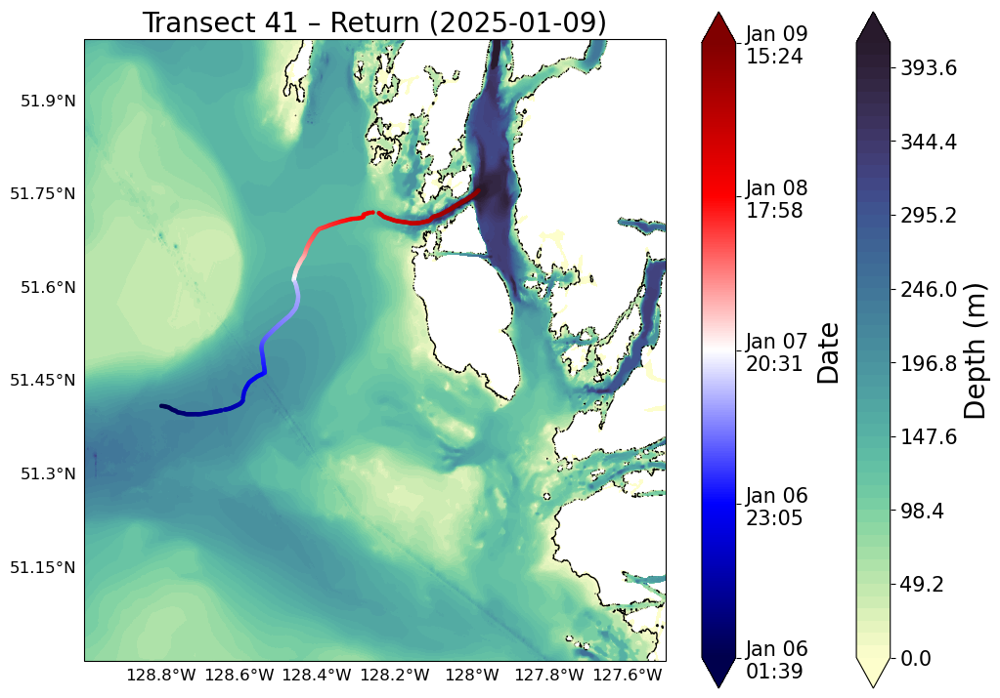

In [14]:
def plot_transect_on_map(cube, transect_indices=None, long_bounds=None, lat_bounds=None,
                         topo_file=os.path.expanduser('~/Desktop/british_columbia_3_msl_2013.nc')):
    if transect_indices is None:
        transect_indices = list(range(cube.dims['transect']))

    # Preload topo once
    topo = xr.open_dataset(topo_file)

    for i in transect_indices:
        ds = cube.sel(transect=i)
        lons = ds['longitude'].values
        lats = ds['latitude'].values
        time_vals = ds['time'].values

        # Ensure time is valid and in datetime64
        if len(time_vals) == 0 or np.all(pd.isna(time_vals)):
            print(f"Skipping transect {i} (invalid time values)")
            continue

        # Convert to datetime and create mask
        time_vals = pd.to_datetime(time_vals, errors='coerce')
        valid_mask = ~pd.isna(time_vals)
        if valid_mask.sum() < 2:
            print(f"Skipping transect {i} (not enough valid time points)")
            continue

        # Apply mask consistently
        lons = lons[valid_mask]
        lats = lats[valid_mask]
        time_vals = time_vals[valid_mask]
        time_nums = mdates.date2num(time_vals)

        # Skip empty coordinate arrays
        if len(lons) == 0 or len(lats) == 0 or np.all(np.isnan(lons)) or np.all(np.isnan(lats)):
            print(f"Skipping transect {i} (empty or NaN coordinates)")
            continue

        # Auto-bounds per transect
        lon_b = [np.nanmin(lons) - 0.25, np.nanmax(lons) + 0.25] if long_bounds is None else long_bounds
        lat_b = [np.nanmin(lats) - 0.25, np.nanmax(lats) + 0.25] if lat_bounds is None else lat_bounds

        # Subset topo
        topo_sub = topo.sel(
            lon=slice(lon_b[0], lon_b[1]),
            lat=slice(lat_b[0], lat_b[1])
        )
        topo_var = -topo_sub['Band1']

        # Create map
        fig, ax = plt.subplots(figsize=(12, 9), subplot_kw={'projection': ccrs.PlateCarree()})
        ax.set_extent(lon_b + lat_b, crs=ccrs.PlateCarree())

        # Gridlines
        gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0)
        gl.top_labels = False
        gl.right_labels = False

        # Bathymetry
        levels = np.linspace(0, 410, 51)
        contourf = ax.contourf(topo_sub['lon'], topo_sub['lat'], topo_var,
                               levels=levels, cmap=cm.cm.deep, extend='both')
        fig.colorbar(contourf, ax=ax, label='Depth (m)')
        ax.contour(topo_sub['lon'], topo_sub['lat'], topo_var, levels=[0.5], colors='black', linewidths=1)

        # Glider track with time-based color
        sc = ax.scatter(lons, lats, c=time_nums, cmap='seismic',
                        vmin=time_nums.min(), vmax=time_nums.max(),
                        s=5, transform=ccrs.PlateCarree(), label='Glider Track')

        cbar = fig.colorbar(sc, ax=ax, orientation='vertical', extend='both')
        cbar.set_label('Date')

        # Format date ticks
        tick_locs = np.linspace(time_nums.min(), time_nums.max(), num=5)
        cbar.set_ticks(tick_locs)
        cbar.set_ticklabels([mdates.num2date(t).strftime('%b %d\n%H:%M') for t in tick_locs])

        # Title and layout
        mission = ds['mission_type'].item() if 'mission_type' in ds.coords else "Unknown"
        tstr = pd.to_datetime(ds['transect_time'].values).strftime('%Y-%m-%d') if 'transect_time' in ds.coords else ""
        ax.set_title(f"Transect {i + 1} – {mission} ({tstr})")
        ax.set_aspect(1 / np.cos(np.deg2rad(np.mean(lat_b))))

plot_transect_on_map(cube, lat_bounds= (51, 52), long_bounds= (-129, -127.5))

In [15]:
# file_pathway = '/Users/martinwilliamson/CalvertLine_reprocessed/dfo-k999-20241119_grid_delayed.nc'
# ds = xr.open_dataset(file_pathway)
# plot_mission(ds)
# file_pathway = '/Users/martinwilliamson/CalvertLine_reprocessed/dfo-k999-20241023_grid_delayed.nc'
# ds = xr.open_dataset(file_pathway)
# plot_mission(ds)

In [16]:
# file_pathway = '/Users/martinwilliamson/CalvertLine_reprocessed/dfo-hal1002-20240723_grid_delayed.nc'
# ds = xr.open_dataset(file_pathway)
# plot_mission(ds)

In [17]:
# file_pathway = ('/Users/martinwilliamson/CalvertLine_reprocessed/dfo-k999-20230915_grid_delayed.nc')
# ds = xr.open_dataset(file_pathway)
# plot_mission(ds)

In [18]:
# def process_calvert_files(directory='~/CalvertLine/'):
#     directory = os.path.expanduser(directory)
#     file_paths = sorted(glob.glob(os.path.join(directory, '*.nc')))
#     file_paths = [f for f in file_paths if '/dfo-' in f]

#     # Define waypoint coordinates
#     waypoint_lon = np.array([-127.950, -128.115, -128.243, -128.514, -128.646, -128.798])
#     waypoint_lat = np.array([51.757, 51.705, 51.715, 51.450, 51.4165, 51.408])
#     central_lat = 51.715

#     results = {}

#     for file_path in file_paths:
#         print(f"Processing: {os.path.basename(file_path)}")

In [19]:
# file_pathway = '/Users/martinwilliamson/CalvertLine_reprocessed/dfo-k999-20241023_grid_delayed.nc'
# plot_mission(xr.open_dataset(file_pathway), lat_bounds = [51.4, 51.8], lon_bounds = [-128.8, -127.9])

# file_pathway = '/Users/martinwilliamson/CalvertLine_reprocessed/dfo-k999-20241119_grid_delayed.nc'
# plot_mission(xr.open_dataset(file_pathway), lat_bounds = [51.4, 51.8], lon_bounds = [-128.8, -127.9])

Some troubleshooting

In [20]:
# file_pathway = '/Users/martinwilliamson/CalvertLine_reprocessed/dfo-k999-20241023_grid_delayed.nc'
# ds = xr.open_dataset(file_pathway)

# # Waypoints
# waypoint_lon = np.array([-127.950, -128.115, -128.243, -128.514, -128.646, -128.798])
# waypoint_lat = np.array([51.757, 51.705, 51.715, 51.450, 51.4165, 51.408])
# central_lat = 51.715

# # Distance projection
# alongx, acrossx, _ = wd.get_simple_distance(
#     shiplon=ds['longitude'].values,
#     shiplat=ds['latitude'].values,
#     wplon=waypoint_lon,
#     wplat=waypoint_lat,
#     central_lat=central_lat)

# # Add along and across to ds
# ds = ds.assign(along=('time', alongx))
# ds = ds.assign(across=('time', acrossx))

# # Separate ds into out and return transects
# gradient_along = np.gradient(ds['along'])
# zero_indices = np.where(gradient_along == 0)[0]
# # Indices to figure out how the out and return should be separated
# # Requires gradient_along to have zeros in the middle, which are created from the projection function and it's bounds
# start = zero_indices[0]
# end = zero_indices[-1] + 1

# print(gradient_along)
# # Creating the masks
# out_mask = np.zeros_like(gradient_along, dtype=bool)
# return_mask = np.zeros_like(gradient_along, dtype=bool)
# out_mask[:start] = gradient_along[:start] > 0
# return_mask[end:] = gradient_along[end:] < 0

# # Defining new ds, one for each part of the trip
# ds_out = ds.sel(time=out_mask)
# ds_return = ds.sel(time=return_mask)

# # Iteratively remove points from glider loops (outbound)
# prev_len = -1
# while prev_len != len(ds_out['time']):
#     prev_len = len(ds_out['time'])
#     grad = np.gradient(ds_out['along'])
#     keep_mask = grad > 0
#     ds_out = ds_out.sel(time=keep_mask)

# # Iteratively remove points from glider loops (returnbound)
# prev_len = -1
# while prev_len != len(ds_return['time']):
#     prev_len = len(ds_return['time'])
#     grad = np.gradient(ds_return['along'])
#     keep_mask = grad < 0
#     ds_return = ds_return.sel(time=keep_mask)

# # Combine back into ds, plot. Data is now clean, not yet horizontally gridded
# ds = xr.concat([ds_out, ds_return], dim='time')
# # plot_mission(ds, file_pathway,lat_bounds = lat_bounds, lon_bounds = long_bounds)
# # plot_mission(ds_out, file_path = '/Users/martinwilliamson/Desktop/dfo-bb046-20210324_grid_delayed.nc',  lat_bounds = lat_bounds, long_bounds = long_bounds)
# # plot_mission(ds_return, file_path = '/Users/martinwilliamson/Desktop/dfo-bb046-20210324_grid_delayed.nc',  lat_bounds = lat_bounds, long_bounds = long_bounds)

In [ ]:
# for value in alongx:
#     print(value)

In [ ]:
# file_pathway = '/Users/martinwilliamson/CalvertLine_reprocessed/dfo-colin1142-20240312_grid_delayed.nc'
# plot_mission(xr.open_dataset(file_pathway))

In [ ]:
# os.remove('/Users/martinwilliamson/Desktop/calvert_cube.nc')
# file_pathway = '/Users/martinwilliamson/CalvertLine_reprocessed/dfo-colin1142-20240312_grid_delayed.nc'
# add_file_to_cube(file_pathway)
# cube = xr.open_dataset('/Users/martinwilliamson/Desktop/calvert_cube.nc')
# ds_out, ds_return = clean_mission(file_pathway)
# plot_transect_on_map(cube)
# plot_all_sections(cube)

In [21]:
file_pathway = '/Users/martinwilliamson/CalvertLine_reprocessed/dfo-hal1002-20240924_grid_delayed.nc'
ds = xr.open_dataset(file_pathway)

# Project onto along/across coordinate system
waypoint_lon = np.array([-127.950, -128.115, -128.243, -128.514, -128.646, -128.798])
waypoint_lat = np.array([51.757, 51.705, 51.715, 51.450, 51.4165, 51.408])
central_lat = 51.715

alongx, acrossx, _ = wd.get_simple_distance(
    shiplon=ds['longitude'].values,
    shiplat=ds['latitude'].values,
    wplon=waypoint_lon,
    wplat=waypoint_lat,
    central_lat=central_lat)

ds = ds.assign(along=('time', alongx), across=('time', acrossx))

# Split at maximum along distance (turnaround point)
peak_idx = int(np.argmax(ds['along'].values))

ds_out = ds.isel(time=slice(0, peak_idx + 1))
ds_return = ds.isel(time=slice(peak_idx + 1, None))

# Clean loops separately in each leg
for leg, name in [(ds_out, "out"), (ds_return, "return")]:
    if leg['time'].size < 2 or np.count_nonzero(~np.isnan(leg['along'])) < 10:
        print(f"Skipping {name} leg: not enough points to clean.")
        if name == "out":
            ds_out = None
        else:
            ds_return = None
        continue

    prev_len = -1
    while prev_len != len(leg['time']):
        prev_len = len(leg['time'])
        if len(leg['along']) < 2:
            print(f"Stopping cleaning for {name} leg: insufficient points for gradient.")
            break
        grad = np.gradient(leg['along'])
        keep_mask = grad > 0 if name == "out" else grad < 0
        leg = leg.sel(time=keep_mask)

    # Final filtering: must have enough non-NaN `along` values
    if np.count_nonzero(~np.isnan(leg['along'])) < 100:
        print(f"Dropping {name} leg after cleaning: too few valid points.")
        if name == "out":
            ds_out = None
        else:
            ds_return = None
        continue

    if name == "out":
        ds_out = interpolate(leg.set_coords('along'))
    else:
        ds_return = interpolate(leg.set_coords('along'))


Stopping cleaning for return leg: insufficient points for gradient.
Dropping return leg after cleaning: too few valid points.


In [2]:
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
import os
import matplotlib.dates as mdates
import cmocean as cm
import waypoint_distance as wd
import pandas as pd

In [3]:
ds = xr.open_dataset(os.path.expanduser('~/Desktop/cleaned_transects/dfo-hal1002-20220914_grid_delayed_return.nc'))
ds

<xarray.Dataset> Size: 199MB
Dimensions:                (depth: 1100, along: 1255, transect: 1)
Coordinates:
  * depth                  (depth) float64 9kB 0.5 1.5 2.5 ... 1.098e+03 1.1e+03
    profile                (along) float64 10kB ...
    longitude              (along) float64 10kB ...
    latitude               (along) float64 10kB ...
  * along                  (along) float64 10kB 1.415e+04 1.42e+04 ... 7.685e+04
  * transect               (transect) int64 8B 19
Data variables: (12/21)
    heading                (transect, depth, along) float64 11MB ...
    pitch                  (transect, depth, along) float64 11MB ...
    roll                   (transect, depth, along) float64 11MB ...
    waypoint_latitude      (transect, depth, along) float64 11MB ...
    waypoint_longitude     (transect, depth, along) float64 11MB ...
    conductivity           (transect, depth, along) float64 11MB ...
    ...                     ...
    potential_temperature  (transect, depth, along) float64 11MB ...
    profile_index          (transect, depth, along) float64 11MB ...
    profile_direction      (transect, depth, along) float64 11MB ...
    mission_number         (transect) int32 4B ...
    across                 (transect, along) float64 10kB ...
    time                   (transect, along) datetime64[ns] 10kB ...
Attributes: (12/65)
    Conventions:               CF-1.8
    Metadata_Conventions:      CF-1.6, Unidata Dataset Discovery v1.0
    acknowledgement:           Funding from Fisheries and Oceans Canada, Cana...
    comment:                   Calvert Island deployment
    contributor_name:          James Pegg, Tetjana Ross, Jody Klymak, Hayley ...
    contributor_role:          Lead Technician, Principal Investigator, Co-PI...
    ...                        ...
    summary:                   Glider deployed near Calvert Island BC as part...
    time_coverage_end:         2022-10-19T02:15:49
    time_coverage_start:       2022-09-13T15:28:39
    title:                     dfo-hal1002-20220913T1528
    transmission_system:       IRIDIUM
    wmo_id:                    8900996